In [1]:
import seaborn as sns
import numpy as np
import pandas as pd
import scanpy as sc
#import scvelo as scv
import matplotlib.pyplot as plt
import matplotlib as mpl
from anndata import AnnData
from matplotlib import rcParams
import os
import sys
#import bbknn

from scipy.sparse import issparse, isspmatrix_csr, isspmatrix_coo
from scipy.sparse import spmatrix, csr_matrix
from sklearn.utils.sparsefuncs import mean_variance_axis

sc.settings.verbosity = 3
sc.settings.set_figure_params(dpi=150)

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=150, facecolor='white')

scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.22.4 scipy==1.9.1 pandas==1.4.2 scikit-learn==1.1.2 statsmodels==0.13.2 python-igraph==0.9.9 louvain==0.7.1 pynndescent==0.5.7


In [26]:
#adata = sc.read_h5ad("./objects/SS2_gams_new.h5ad")
adata = sc.read_h5ad("../results/single_cell/single_cell_smartseq2_qc.h5ad")
adata

AnnData object with n_obs × n_vars = 916 × 5092
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'n_counts', 'S_score', 'G2M_score', 'phase', 'louvain_0.4', 'leiden_0.4', 'louvain_0.6', 'leiden_0.6', 'louvain_0.8', 'leiden_0.8', 'louvain_0.9', 'leiden_0.9', 'louvain_1.0', 'leiden_1.0', 'louvain_1.1', 'leiden_1.1', 'louvain_1.2', 'leiden_1.2', 'louvain_1.4', 'leiden_1.4', 'louvain_1.6', 'leiden_1.6', 'day'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'ribo', 'hb', 'mal_rna', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'day_colors', 'hvg', 'leiden', 'leiden_0.4_colors', 'leiden_0.6_colors', 'leiden_0.8_colors', 'leiden_0.9_colors', 'leiden_1.0_colors', 'leiden_1.1_colors', 'leiden_1.2_colors', 'leiden_1.4_colors', 'leiden_1.6_colors', 'log1p', 'louvain', 'louvain_0.4_colo

In [2]:
adata = sc.read_csv("../smart_gam_counts.csv", delimiter=';', first_column_names='Geneid', dtype='float32').T

In [4]:
#adata =sc.read_loom("./files/Velocyte/gams_smart.loom", sparse=True, cleanup=False, X_name='spliced', obs_names='CellID', obsm_names=None, var_names='Geneid', varm_names=None, dtype='float32')

In [5]:
###load counts
#adata = sc.read_csv("ss2_gam_counts.csv", delimiter=';', first_column_names='Gene', dtype='float32').T

In [51]:
##################load loom
#sdata =sc.read_loom("./files/Velocyte/ss2_old.loom", sparse=True, cleanup=False, X_name='spliced', obs_names='CellID', obsm_names=None, var_names='Gene', varm_names=None, dtype='float32')

In [4]:
adata.obs_names

Index(['A10_R1.17_532', 'A10_R1.18_360', 'A10_R1.18_361', 'A11_R1.17_532',
       'A11_R1.18_360', 'A11_R1.18_361', 'A12_R1.17_532', 'A12_R1.18_360',
       'A12_R1.18_361', 'A13_R1.17_532',
       ...
       'N3_R1.18_360', 'N3_R1.18_361', 'N4_R1.17_532', 'N4_R1.18_360',
       'N4_R1.18_361', 'N5_R1.17_532', 'N5_R1.18_360', 'N5_R1.18_361',
       'N6_R1.17_532', 'N6_R1.18_360'],
      dtype='object', length=916)

normalizing counts per cell
    finished (0:00:00)


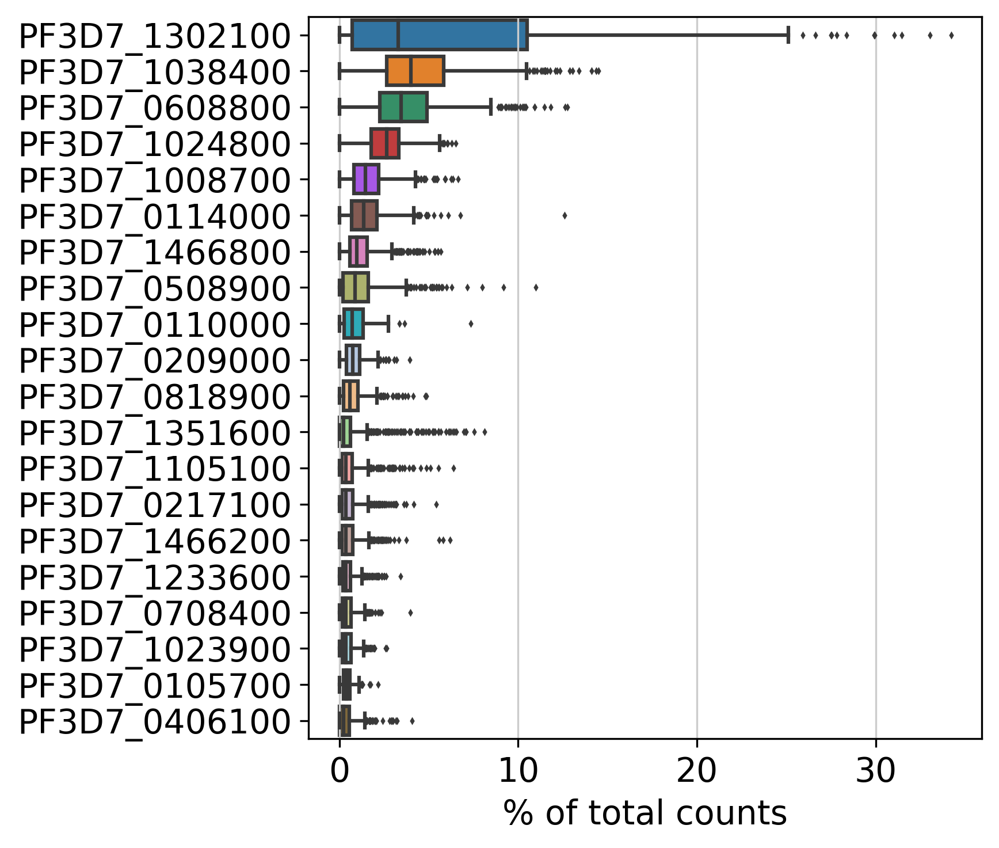

916 5092


In [7]:
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=3)
sc.pl.highest_expr_genes(adata, n_top=20, )
print(adata.n_obs, adata.n_vars)

In [5]:
adata.var_names_make_unique()
adata.var_names
#adata

Index(['PF3D7_1400200', 'PF3D7_1400300', 'PF3D7_1400400', 'PF3D7_1400500',
       'PF3D7_1400600', 'PF3D7_1400700', 'PF3D7_1400800', 'PF3D7_1401100',
       'PF3D7_1401300', 'PF3D7_1401400',
       ...
       'PF3D7_0114500', 'PF3D7_0114700', 'PF3D7_0114800', 'PF3D7_0115000',
       'PF3D7_0115100', 'PF3D7_0115200', 'PF3D7_0115300', 'PF3D7_0115400',
       'PF3D7_0115600', 'PF3D7_0115700'],
      dtype='object', length=5092)

In [55]:
#adata.var_names = [i.replace('-', '_') for i in adata.var_names]
#adata.var.features = [i.replace('-', '_') for i in adata.var.features]

In [8]:
print(adata.n_obs, adata.n_vars)
adata

916 5092


AnnData object with n_obs × n_vars = 916 × 5092
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'ribo', 'hb'

In [9]:
# mitochondrial genes
adata.var['mt'] = adata.var_names.str.startswith('mal-mito-') 
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
# ribosomal genes
adata.var['mal_rna'] = adata.var_names.str.startswith(("RPS","RPL"))
# hemoglobin genes.
adata.var['hb'] = adata.var_names.str.contains(("^HB[^(P)]"))

adata.var

,n_cells,mt,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,ribo,hb,mal_rna
PF3D7_1400200,3,False,3,0.031659,99.672489,29.0,False,False,False
PF3D7_1400300,11,False,11,0.075328,98.799127,69.0,False,False,False
PF3D7_1400400,4,False,4,0.116812,99.563319,107.0,False,False,False
PF3D7_1400500,6,False,6,0.055677,99.344978,51.0,False,False,False
PF3D7_1400600,13,False,13,0.022926,98.580786,21.0,False,False,False
...,...,...,...,...,...,...,...,...,...
PF3D7_0115200,41,False,41,0.243450,95.524017,223.0,False,False,False
PF3D7_0115300,14,False,14,0.016376,98.471616,15.0,False,False,False
PF3D7_0115400,6,False,6,0.006550,99.344978,6.0,False,False,False
PF3D7_0115600,49,False,49,0.056769,94.650655,52.0,False,False,False


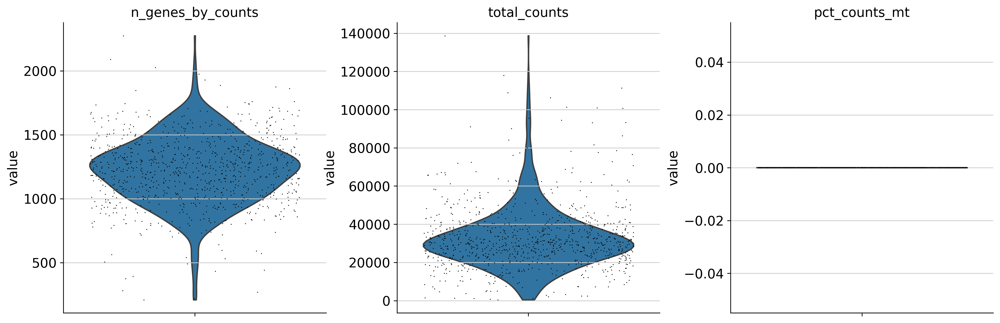

In [10]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

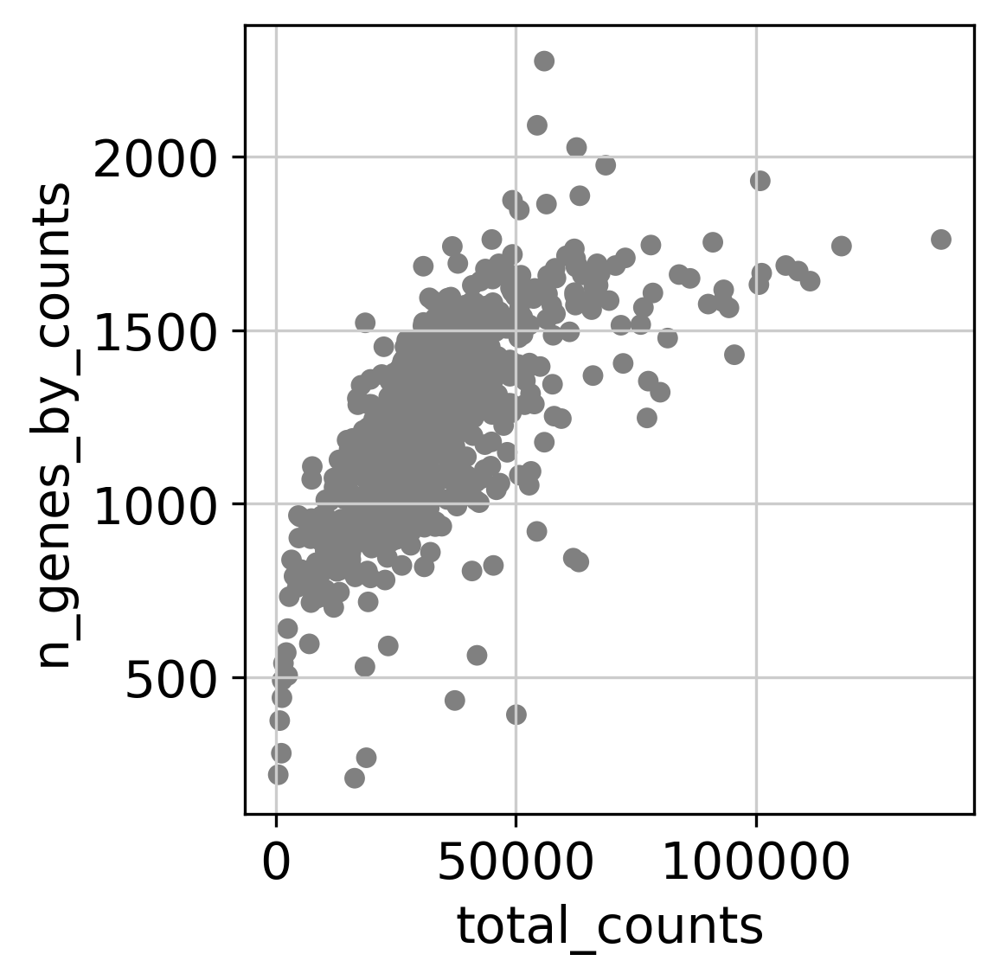

In [11]:
#sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [12]:
# save normalized counts in raw slot.
adata.raw = adata

# normalize to depth 10000 UMIs per cell
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)

# logaritmize
sc.pp.log1p(adata)
# scale
#sc.pp.scale(adata)

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


In [13]:
os.makedirs('./results/supplementary_files', exist_ok=True)

In [14]:
# Load gene list from file
cell_cycle_genes = [x.strip() for x in open('../cc_genesMMS.txt')]

# Split into 2 lists
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]

# Filter out genes not detectd in our dataset 
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata.var_names]

In [15]:
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    810 total control genes are used. (0:00:00)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    921 total control genes are used. (0:00:00)
-->     'phase', cell cycle phase (adata.obs)


/home/mubasher/.conda/envs/spatial/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/home/mubasher/.conda/envs/spatial/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


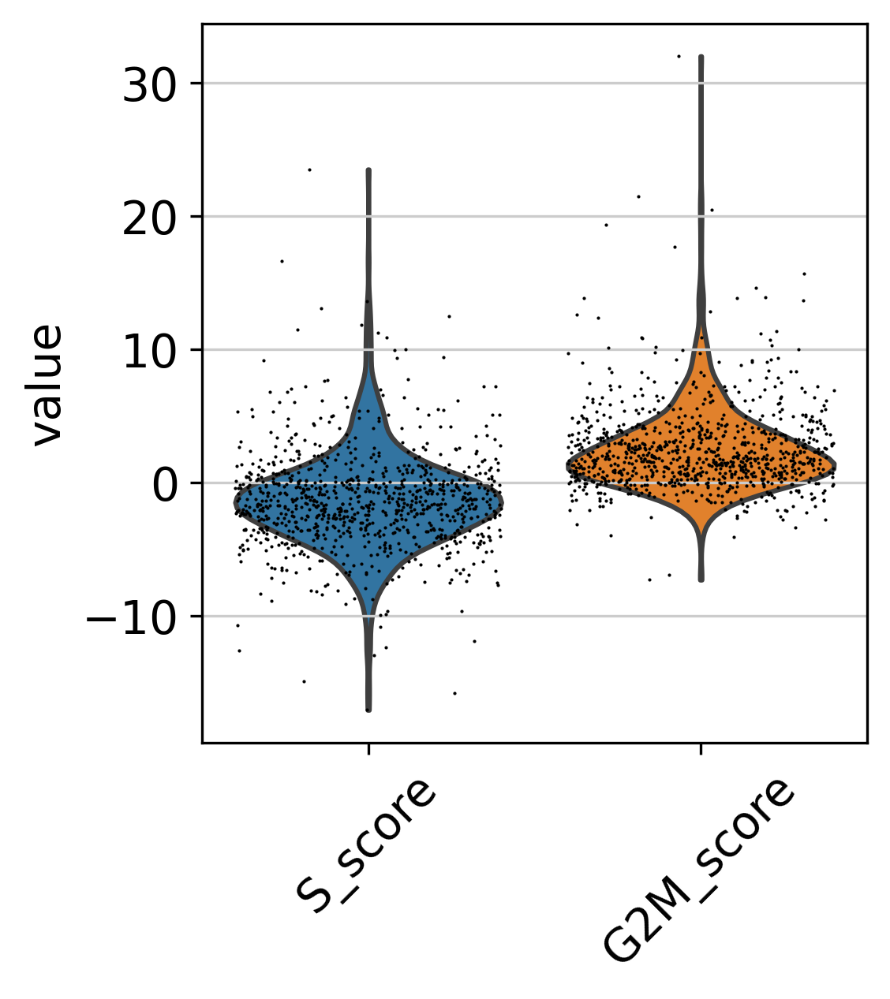

In [16]:
sc.pl.violin(adata, ['S_score', 'G2M_score'], jitter=0.4, rotation=45)

In [17]:
sc.pp.highly_variable_genes(
    adata, n_top_genes=5000,
    inplace=True)
print("Highly variable genes: %d"%sum(adata.var.highly_variable))

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
Highly variable genes: 5000


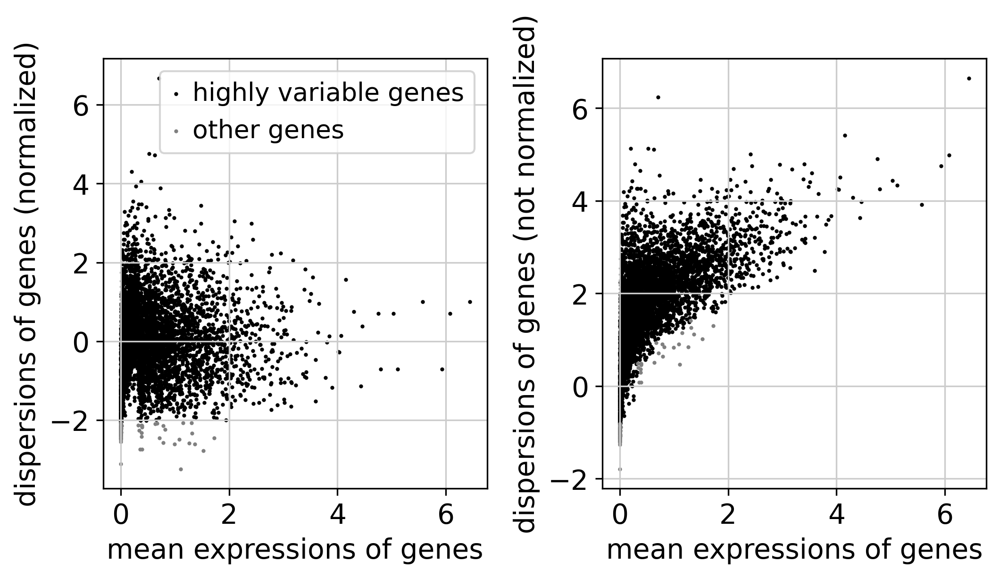

In [18]:
#plot variable genes
sc.pl.highly_variable_genes(adata)

# subset for variable genes in the dataset
#adata = adata[:, adata.var['highly_variable']]

In [19]:
# adata = adata.copy()     #run this line if you get the "AttributeError: swapaxes not found" 
#adata.raw = adata
# regress out unwanted variables
sc.pp.regress_out(adata, ['total_counts'])

# scale data, clip values exceeding standard deviation 10.
sc.pp.scale(adata)

regressing out ['total_counts']
    finished (0:00:14)


In [20]:
adata.var.highly_variable

PF3D7_1400200    True
PF3D7_1400300    True
PF3D7_1400400    True
PF3D7_1400500    True
PF3D7_1400600    True
                 ... 
PF3D7_0115200    True
PF3D7_0115300    True
PF3D7_0115400    True
PF3D7_0115600    True
PF3D7_0115700    True
Name: highly_variable, Length: 5092, dtype: bool

In [21]:
sc.tl.pca(
    data = adata, 
    svd_solver = 'arpack',
    n_comps = 50,
    use_highly_variable = True)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)


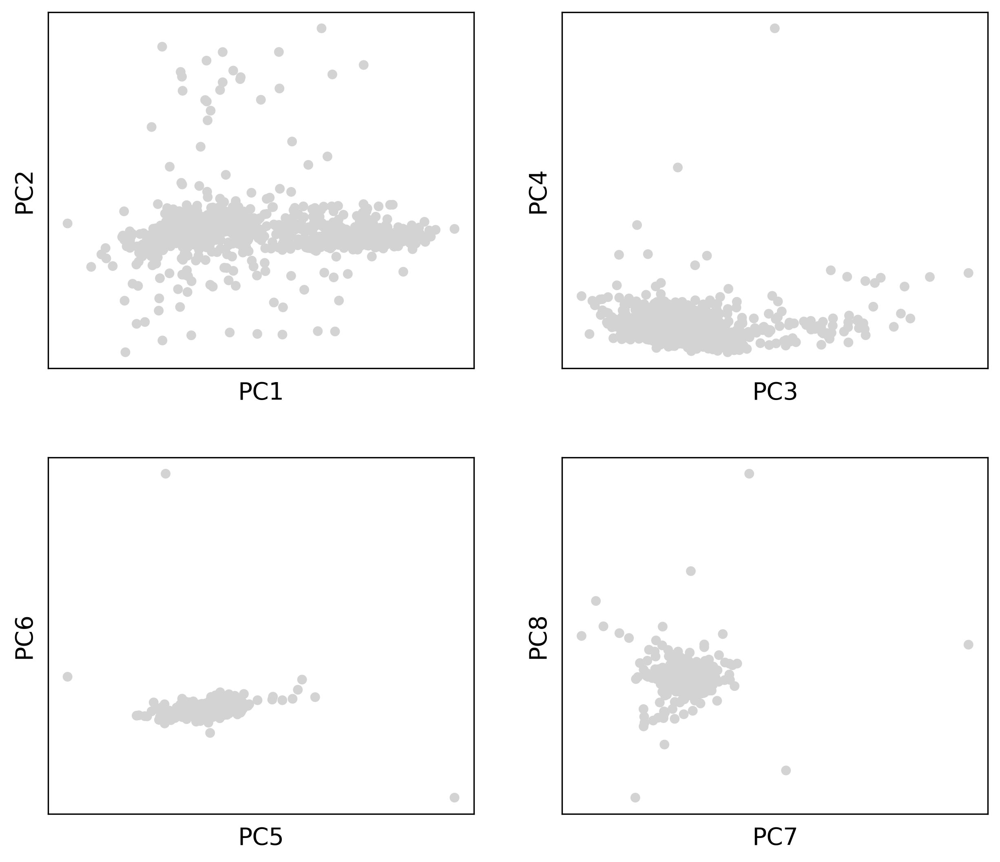

In [22]:
sc.pl.pca(adata, components = ['1,2','3,4','5,6','7,8'], ncols=2)

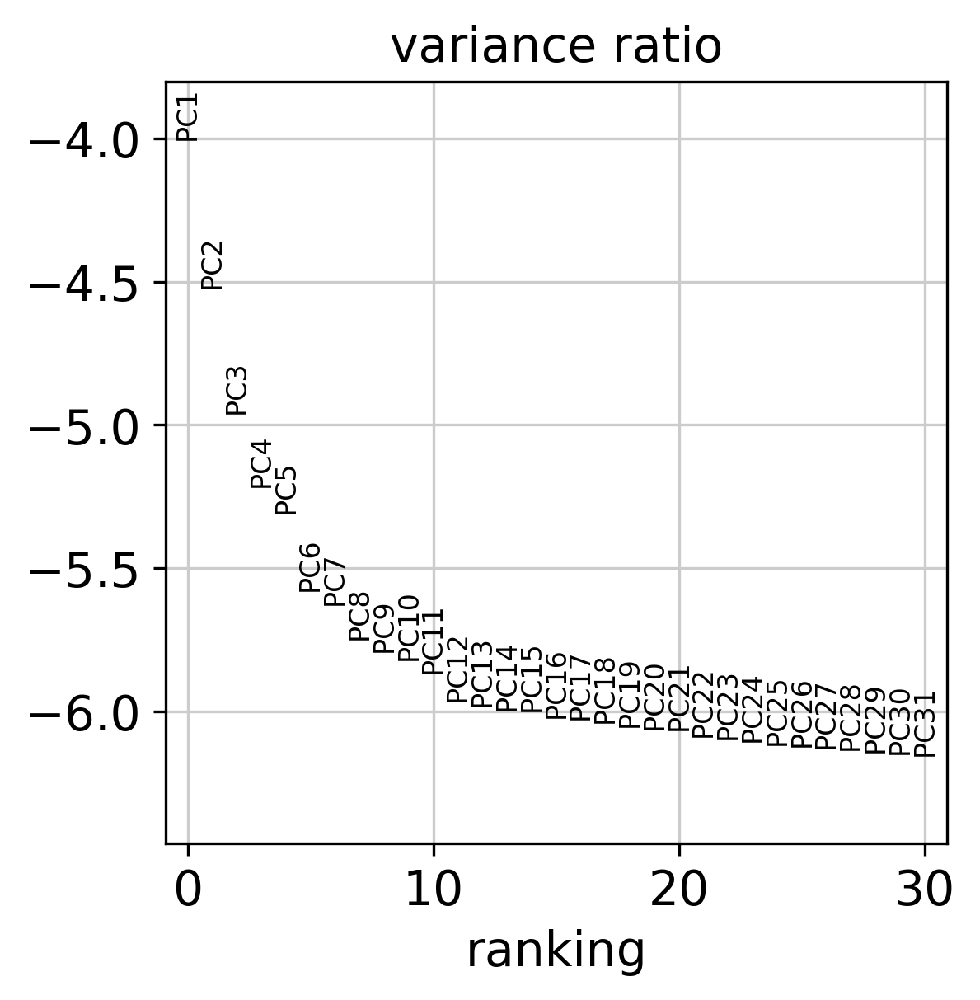

In [23]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs = 30)

In [24]:
sc.pp.neighbors(adata, n_neighbors=20, n_pcs=10) #10

computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)


In [25]:
sc.tl.umap(adata,min_dist=0.3,spread=0.5,maxiter=150)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


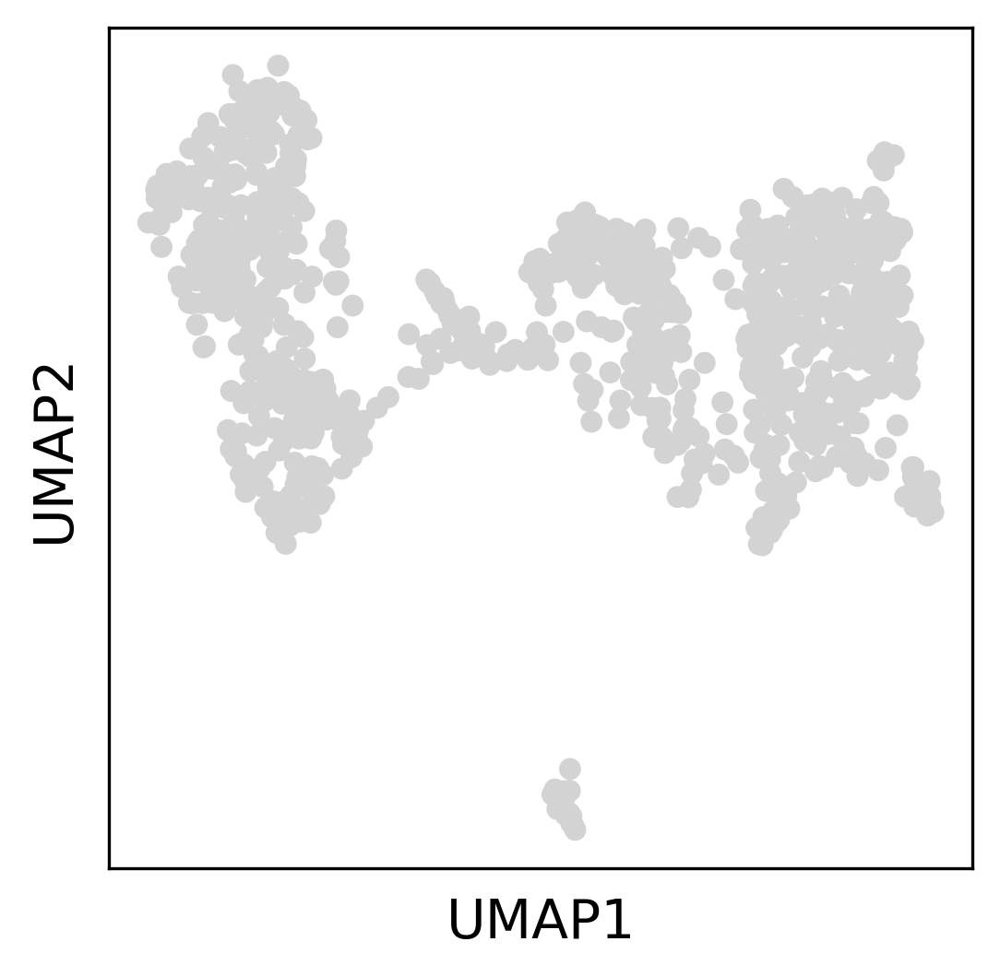

In [26]:
sc.pl.umap(adata)

In [27]:
resolutions = [0.4,0.6,0.8,0.9,1.0,1.1,1.2,1.4,1.6]
 

In [28]:
for i in resolutions:
    sc.tl.louvain( adata, resolution = i, key_added = "louvain_"+str(i) )
    sc.tl.leiden(  adata, resolution = i, key_added = "leiden_"+str(i) )

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 5 clusters and added
    'louvain_0.4', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 7 clusters and added
    'leiden_0.4', the cluster labels (adata.obs, categorical) (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 7 clusters and added
    'louvain_0.6', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 8 clusters and added
    'leiden_0.6', the cluster labels (adata.obs, categorical) (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 8 clusters and added
    'louvain_0.8', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 9 clusters and added
    'leiden_0.8', the cluster labels (adata.obs, categorical) (0:00:00)
running Louvain 

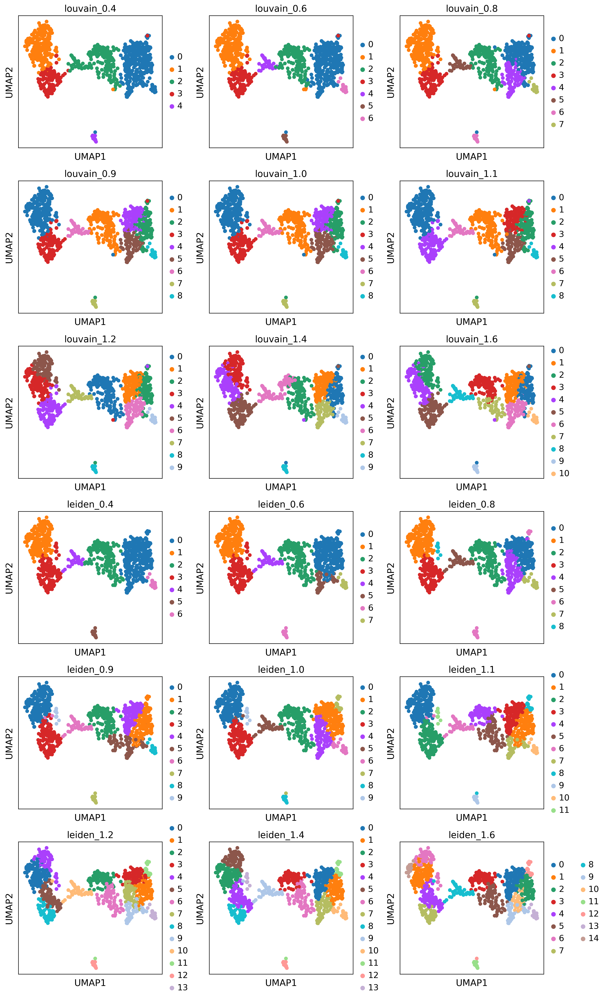

In [29]:
all_clusterings = [ ('louvain_'+str(i)) for i in resolutions] + [ ('leiden_'+str(i)) for i in resolutions ]
sc.pl.umap(adata = adata, color=all_clusterings , ncols=3 )

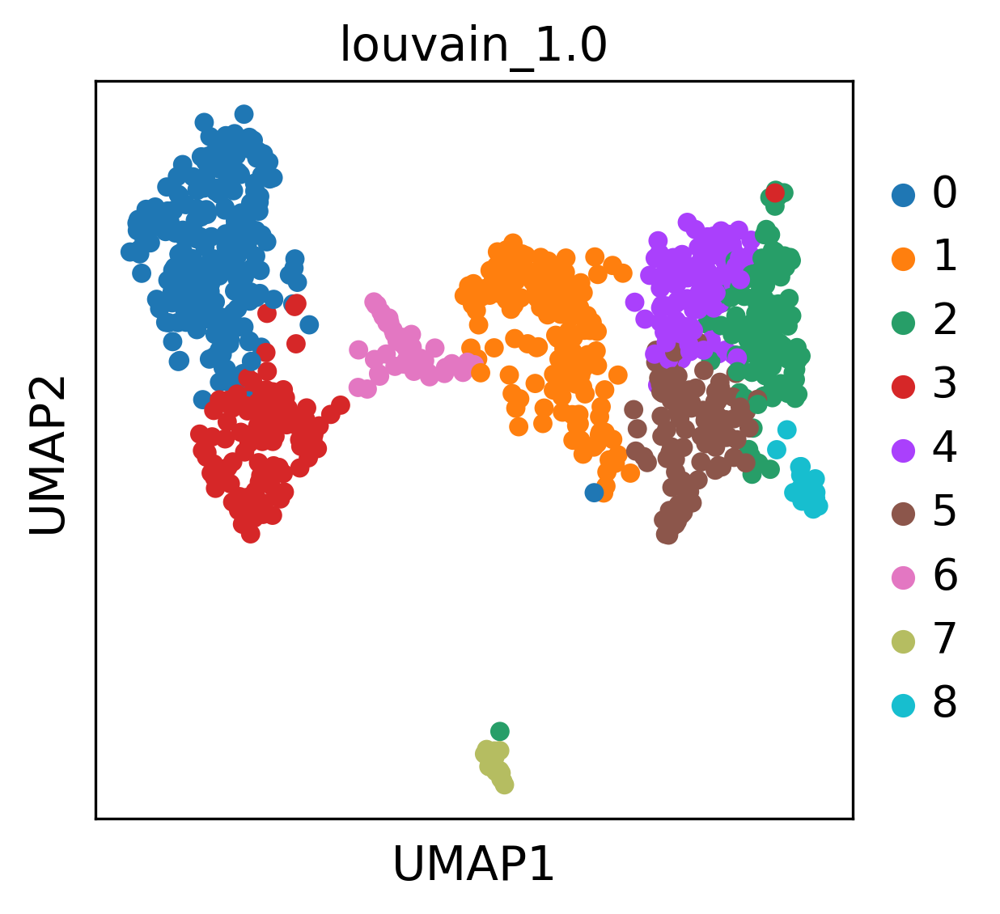

In [30]:
adata
#sc.pl.umap(adata, color=['orig.ident'])
sc.pl.umap(adata, color=['louvain_1.0'])

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 8 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:00)


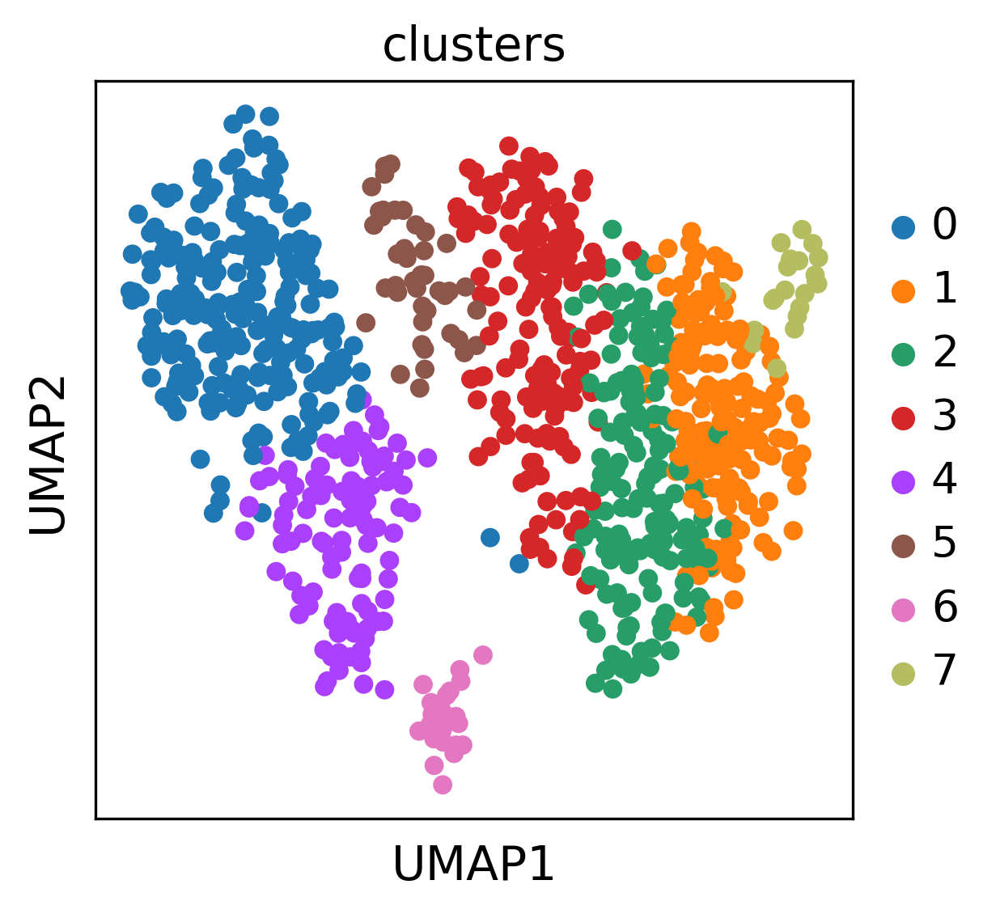

In [81]:
sc.tl.louvain(adata, resolution = 1.0, key_added = "clusters")
sc.pl.umap(adata, color=['clusters'])

In [31]:
adata.obs['day'] = "day"
day_2 =adata.obs_names.str.endswith('17_532')
day_4 =adata.obs_names.str.endswith('18_360')
day_6 = adata.obs_names.str.endswith('18_361')
adata.obs.loc[day_2, 'day'] = 'D2'
adata.obs.loc[day_4, 'day'] = 'D4'
adata.obs.loc[day_6, 'day'] = 'D6'

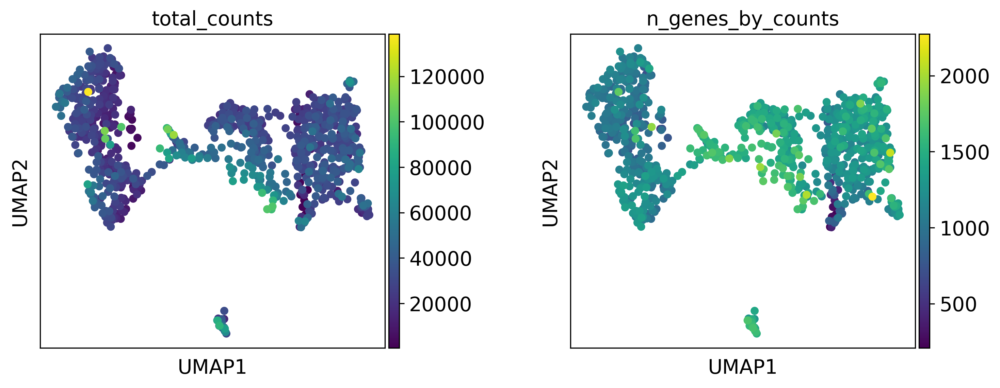

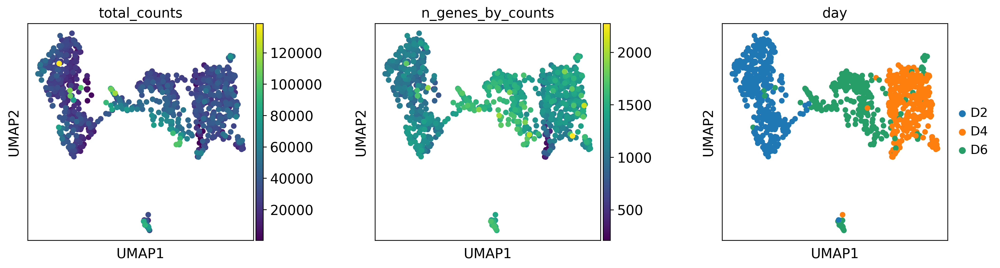

In [33]:
sc.pl.umap(adata, color=["total_counts", "n_genes_by_counts"], wspace=0.4)
sc.pl.umap(adata, color=["total_counts", "n_genes_by_counts", "day"], wspace=0.4)

In [34]:
#adata_subset = adata[adata.obs['clusters_ss2'].isin(['4', '6', '3', '0','9'])]
#adata_subset.write_h5ad("./objects/ss2_gams_early_clusters.h5ad")
#sc.pl.umap(adata_subset, color=['clusters_ss2'])
#sc.pl.pca(adata_subset, color=['clusters_ss2'])
adata.layers['raw_counts'] = adata.raw.X.copy()

In [35]:
print(adata.X.shape)
print(adata.raw.X.shape)
print(adata.raw.X[:10,:15])

(916, 5092)
(916, 5092)
[[ 0.  0.  0.  0.  0.  0.  0.  0. 13.  0.  0.  0.  0.  0.  6.]
 [ 0.  0.  0.  0.  0.  0.  0.  0. 17.  0.  0. 21.  0. 24.  1.]
 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  7.  0.  0.  0.  3. 12.]
 [ 0.  0.  0.  0.  0.  0.  0.  0. 25.  0.  0.  0.  0.  0.  1.]
 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0. 17.  2.]
 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  1.  0.  0.  0.  1.  0.  0.  0.  0.  0.  1.  8.]
 [ 0.  0.  0.  0.  0.  0.  0.  0.  3.  0.  0. 37.  0.  0.  4.]
 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  1.  0.  0.  1.]]


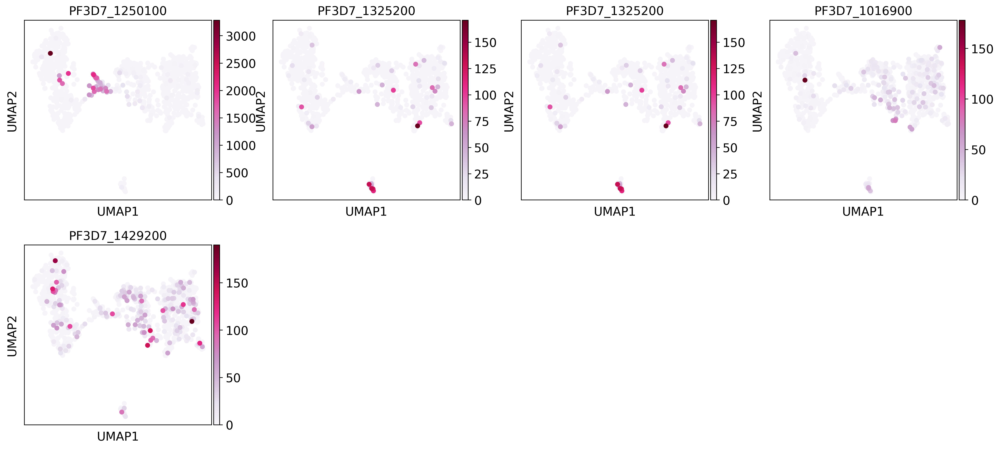

In [41]:
genes = ["PF3D7_1250100", "PF3D7_1325200", "PF3D7_1325200", "PF3D7_1016900", "PF3D7_1429200"]
sc.pl.umap(adata, color = genes, cmap="PuRd", use_raw = True)

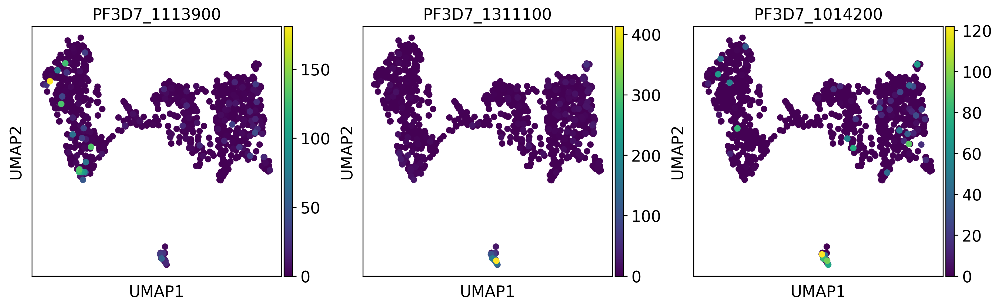

In [37]:
sc.pl.umap(adata, color=['PF3D7_1113900', 'PF3D7_1311100', 'PF3D7_1014200']) #male markers

In [41]:
# Computing differential gene wilcoxon tests (one-vs-rest)
sc.tl.rank_genes_groups(
    adata = adata, 
    groupby = 'clusters', 
    method = 'wilcoxon', 
    use_raw = False, 
    key_added = "wilcoxon")

ranking genes
    finished: added to `.uns['wilcoxon']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


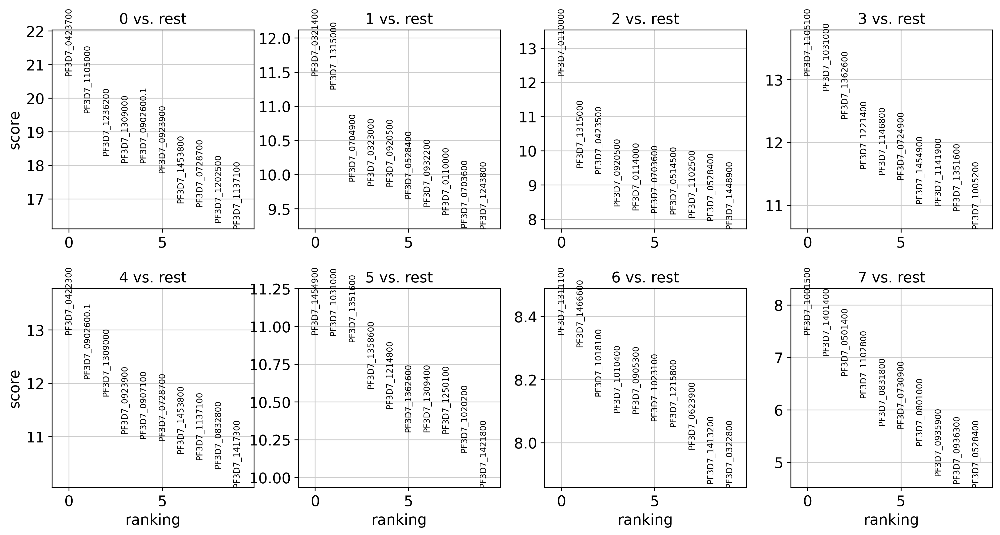

In [42]:
# Plotting top markers per cluster
sc.pl.rank_genes_groups(
    adata = adata, 
    groupby = 'clusters', 
    n_genes=10, 
    sharey=False, 
    key="wilcoxon",)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_clusters']`


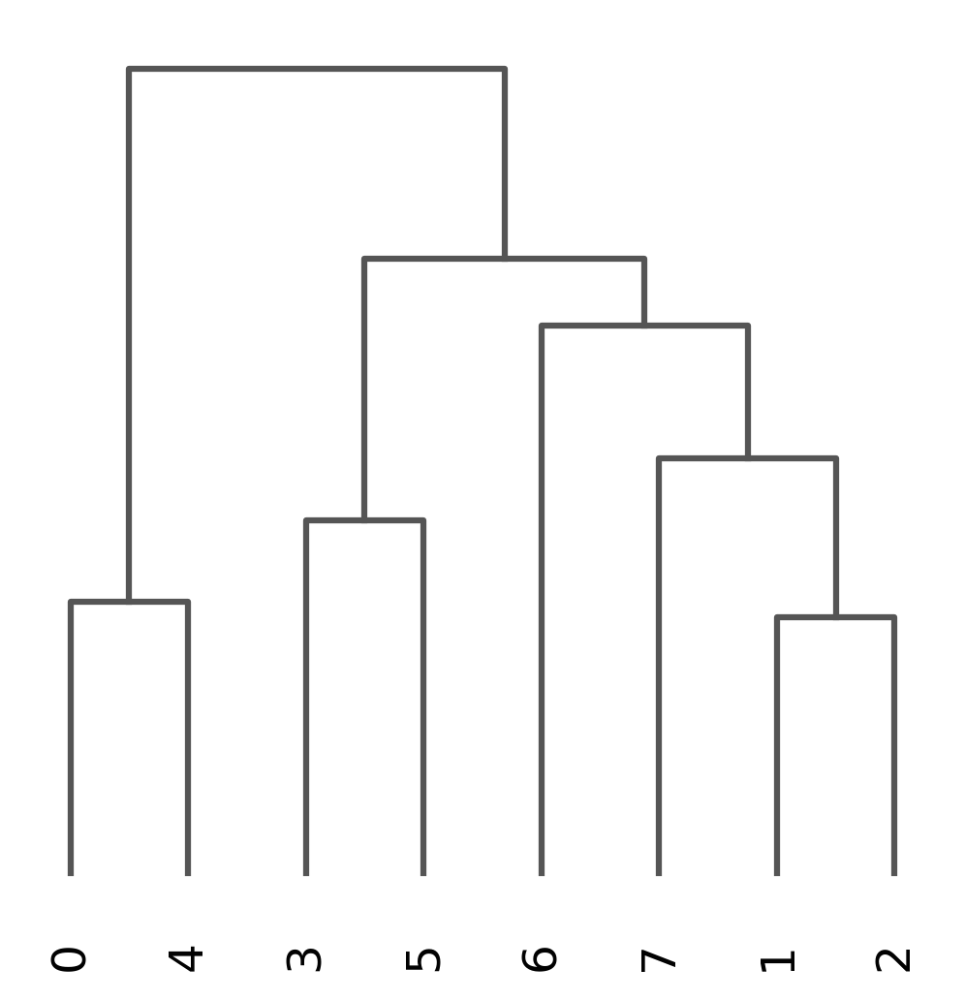

<AxesSubplot:>

In [43]:
sc.tl.dendrogram(adata, groupby='clusters')
sc.pl.dendrogram(adata, groupby= 'clusters')

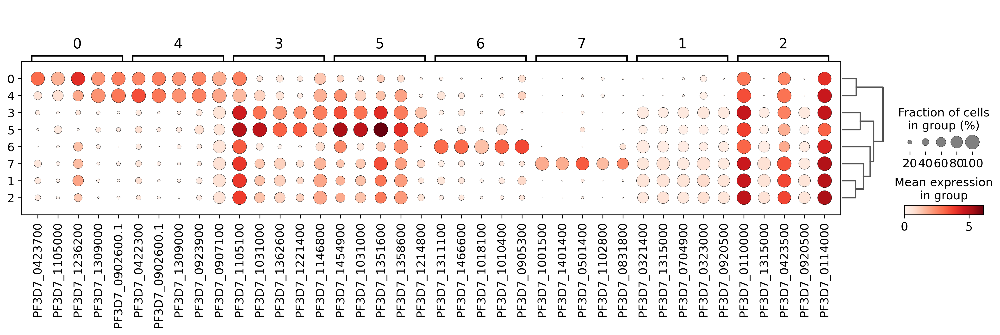

In [44]:
# Dotplot for the top 5 marker genes per cluster
sc.pl.rank_genes_groups_dotplot(
    adata = adata, 
    n_genes = 5, 
    key =  "wilcoxon",
dendrogram=True)

In [23]:
adata

AnnData object with n_obs × n_vars = 998 × 5358
    obs: 'day'

In [86]:
adata.layers['raw_counts'] = adata.raw.X.copy()

In [87]:
os.makedirs('../results/single_cell', exist_ok=True)
adata.write_h5ad('../results/single_cell/single_cell_smartseq2_qc.h5ad')

In [53]:
male_genes = [x.strip() for x in open('male_genes.txt')]
female_genes = [x.strip() for x in open('female_genes.txt')]

print(len(male_genes))
print(len(female_genes))


6
14


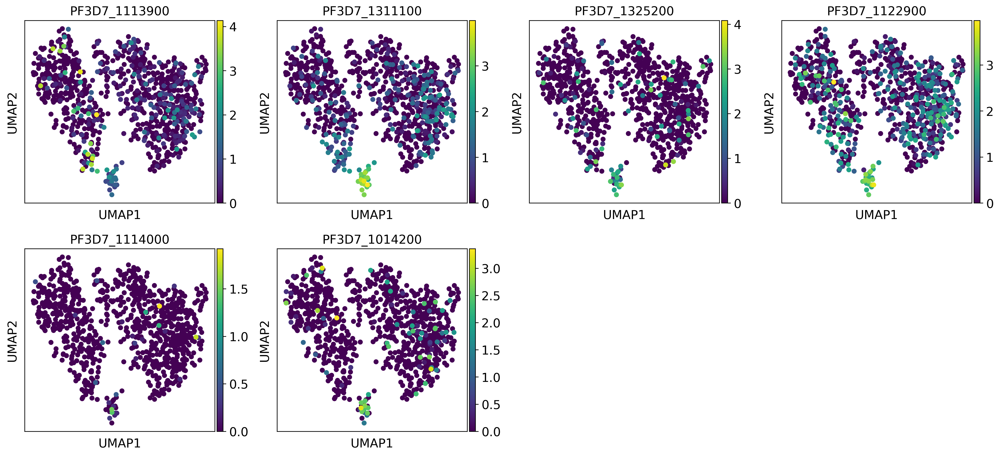

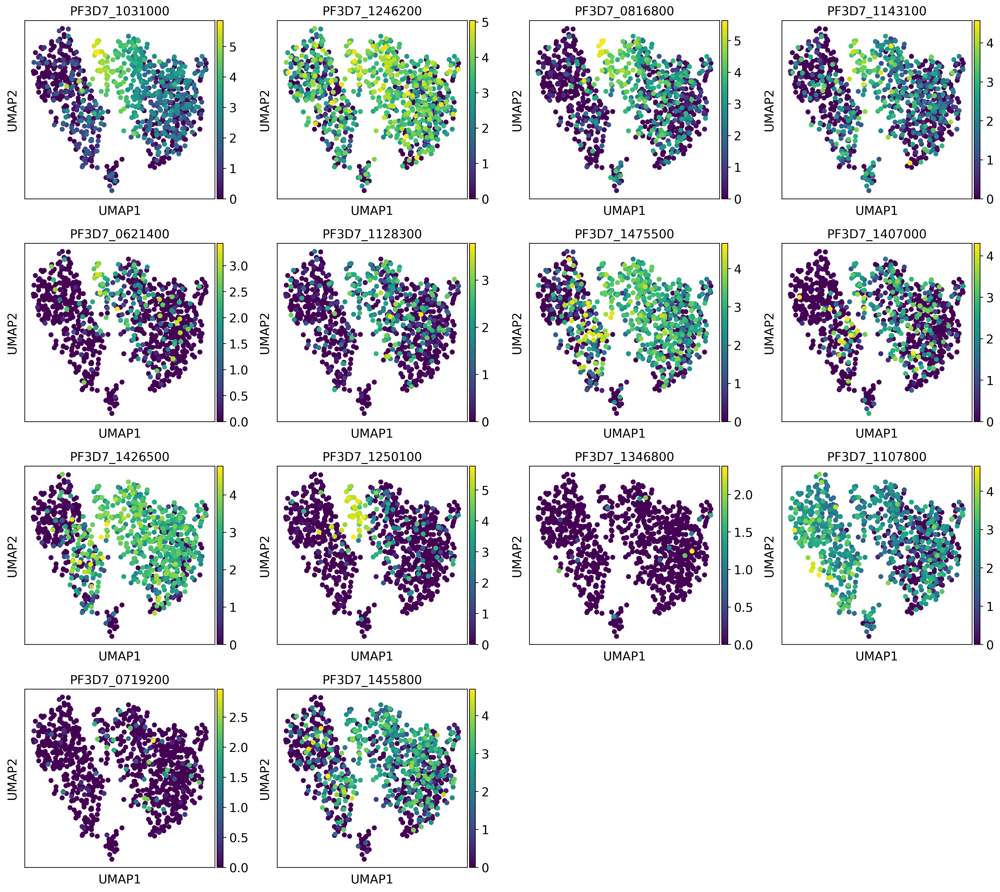

In [54]:
sc.pl.umap(adata, color=male_genes)
sc.pl.umap(adata, color=female_genes)

In [55]:
#sex_score = [x.strip() for x in open('sex_score_markers.txt')]
#print(len(sex_score))

# Split into 2 lists
#male_genes = sex_score[:20]
#female_genes = sex_score[20:]

#sex_score = [x for x in sex_score if x in adata.var_names]
#print(len(sex_score))

In [71]:
#sc.tl.score_genes(adata, male_genes, score_name='male_signature')
#sc.tl.score_genes(adata, female_genes, score_name='female_signature')

In [72]:
#sc.pl.umap(adata, color= ['male_signature', 'female_signature'], color_map='gnuplot', add_outline=False, legend_loc='on data',legend_fontsize=12, legend_fontoutline=2,frameon=True)
#sc.pl.violin(adata, ['male_signature', 'female_signature'], jitter=0.4, groupby = 'clusters', rotation=45, stripplot=False, inner='box')

In [73]:
#sc.pl.dotplot(adata, ['male_signature', 'female_signature'], return_fig=True, groupby='clusters').add_totals().show()

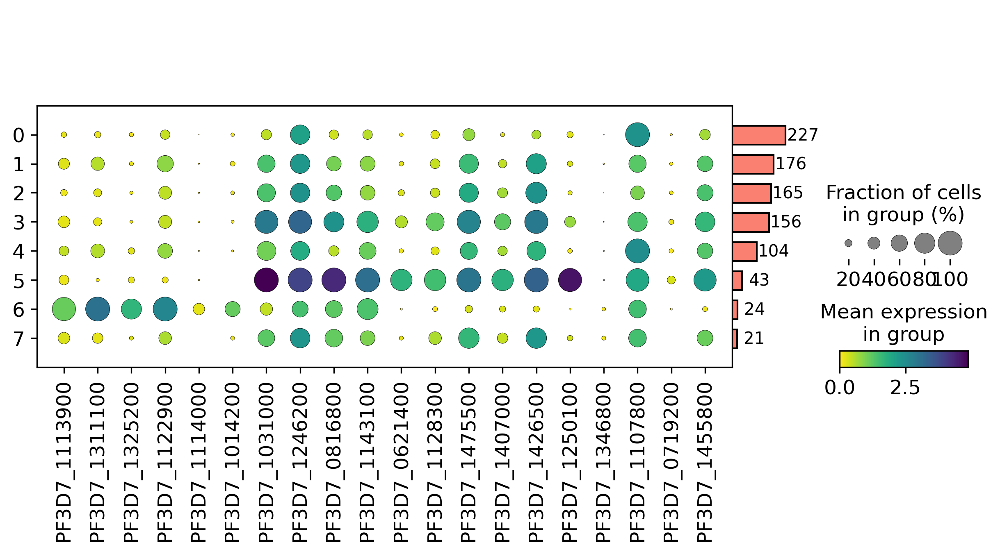

In [56]:
sign_markers= [x.strip() for x in open('sign_markers.txt')]
pd = sc.pl.dotplot(adata, sign_markers, return_fig=True, groupby='clusters', cmap='viridis_r').add_totals().show()

In [57]:
cell_cycle_genes = [x.strip() for x in open('cc_genesMMS.txt')]
print(len(cell_cycle_genes))
s_genes = cell_cycle_genes[:196] 
g2m_genes = cell_cycle_genes[:196] 

cell_cycle_genes = [x for x in cell_cycle_genes if x in adata.var_names]
print(len(cell_cycle_genes))
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

196
193
calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    4549 total control genes are used. (0:00:00)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    4549 total control genes are used. (0:00:00)


/home/mubasher/.conda/envs/spatial/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/home/mubasher/.conda/envs/spatial/lib/python3.9/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


-->     'phase', cell cycle phase (adata.obs)


computing PCA
    with n_comps=50
    finished (0:00:00)


/home/mubasher/.conda/envs/spatial/lib/python3.9/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


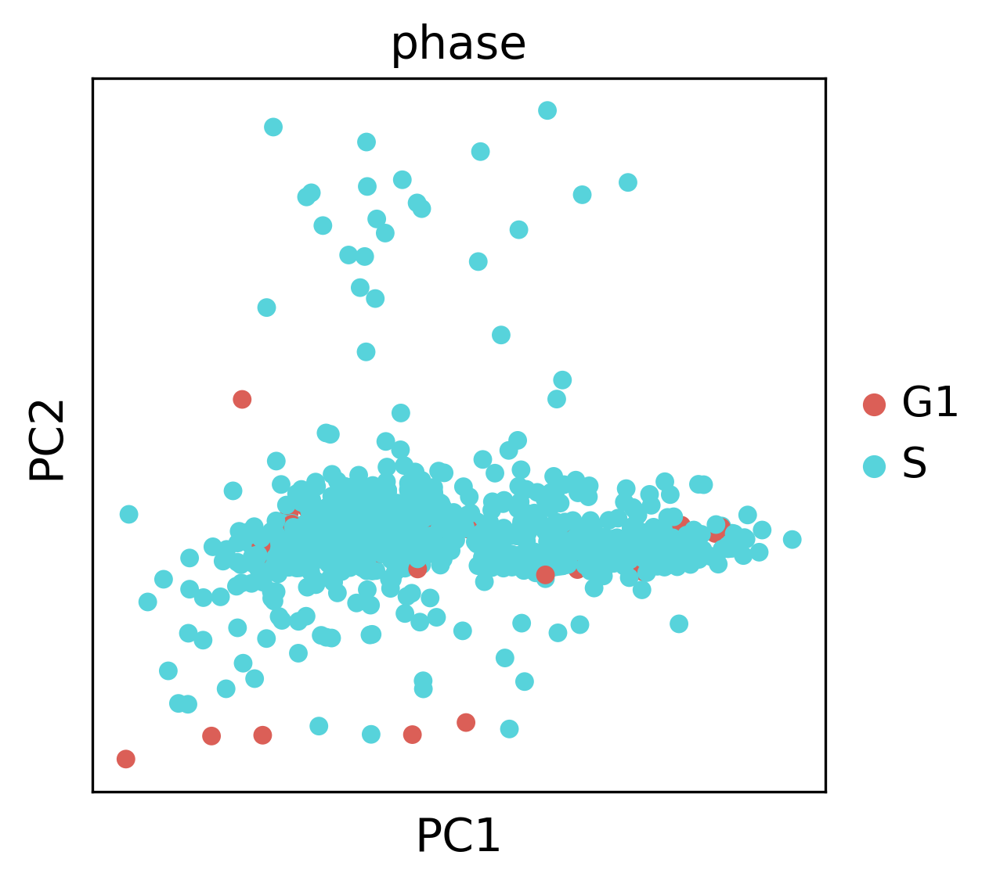

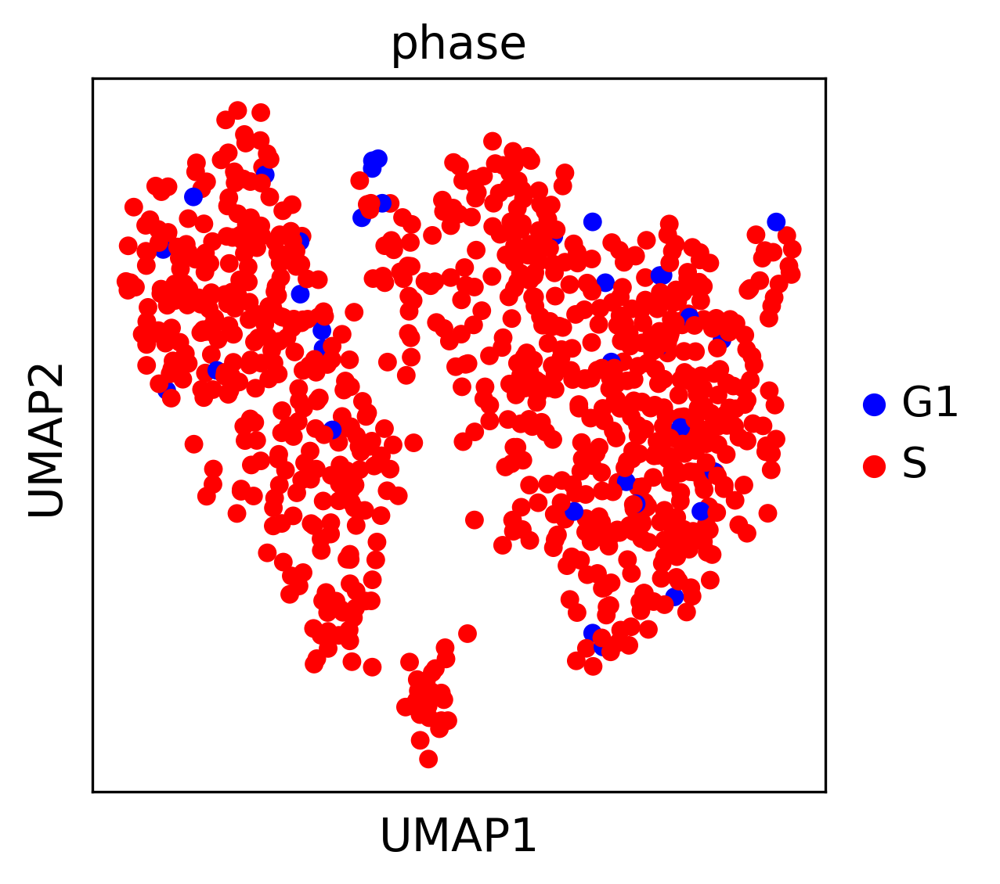

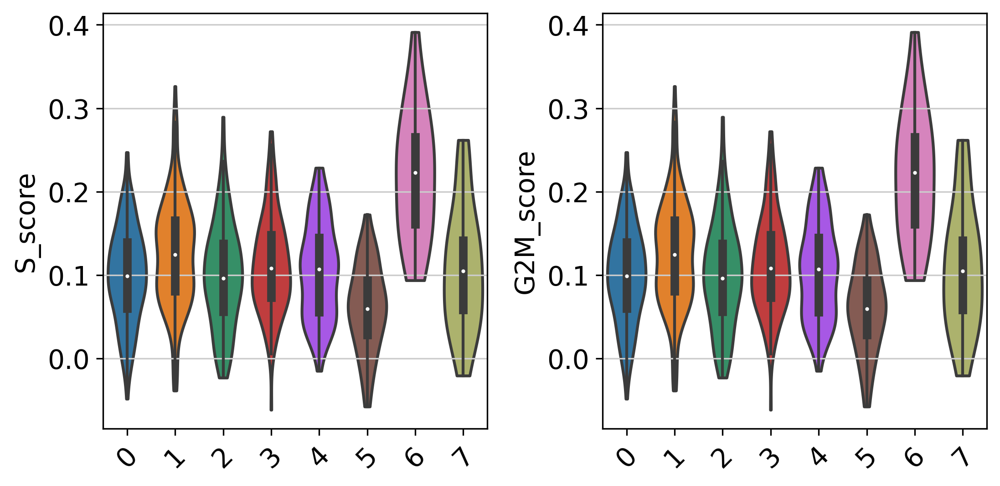

In [58]:
adata_cc_genes = adata[:, cell_cycle_genes]
sc.tl.pca(adata_cc_genes)
sc.pl.pca(adata, components = ['1,2'], ncols=2, color='phase', palette=sns.color_palette("hls", 2))
sc.pl.umap(adata_cc_genes, color=['phase'], palette="bwr")
sc.pl.violin(adata, ['S_score', 'G2M_score'], groupby = 'clusters', jitter=0.4, rotation=45, stripplot=False, inner='box', dpi=120)

regressing out ['S_score', 'G2M_score']
    finished (0:00:13)


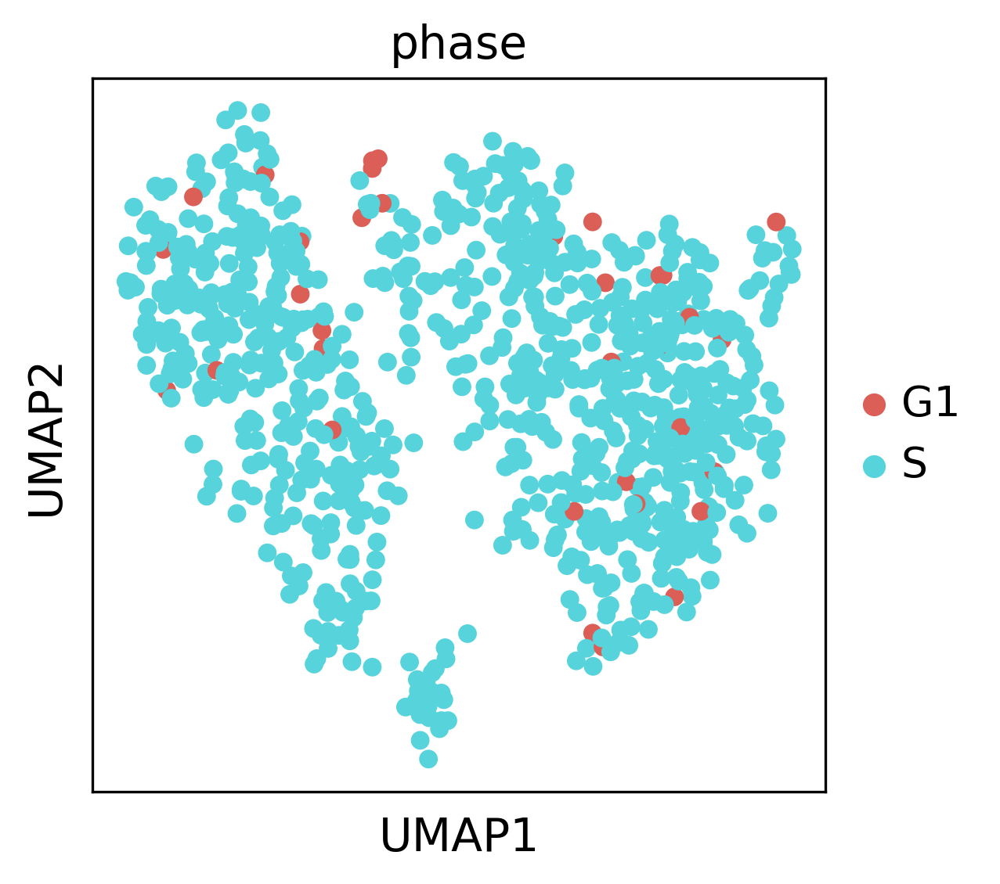

In [59]:
sc.pp.regress_out(adata, ['S_score', 'G2M_score'])
sc.pp.scale(adata)
adata_cc_genes = adata[:, cell_cycle_genes]
#sc.tl.umap(adata_cc_genes)
sc.pl.umap(adata_cc_genes, color=['phase'])

In [78]:
#adata.write_h5ad('./objects/SS2_gams_new.h5ad') ##new object for smart-seq2 data

In [79]:
#tenx = sc.read_h5ad("./objects/10x_gams_early_clusters.h5ad")
#ss2 = sc.read_h5ad("./objects/SS2.h5ad")
#tenx

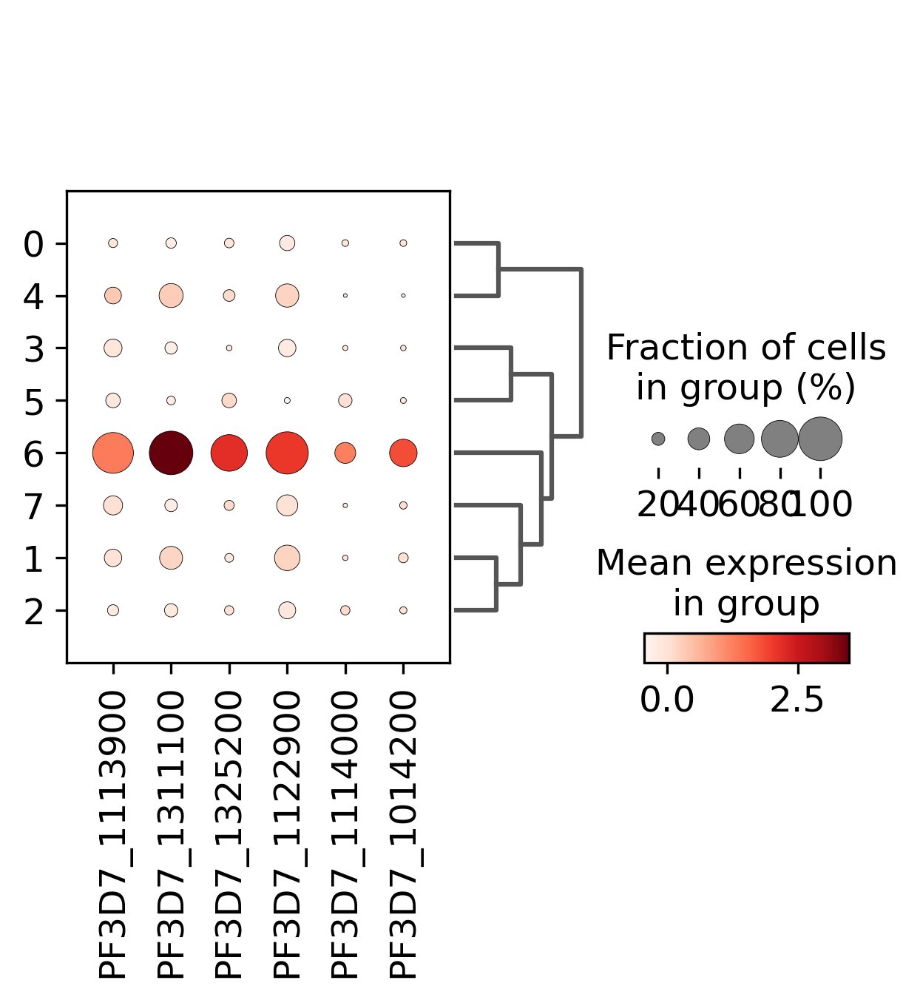

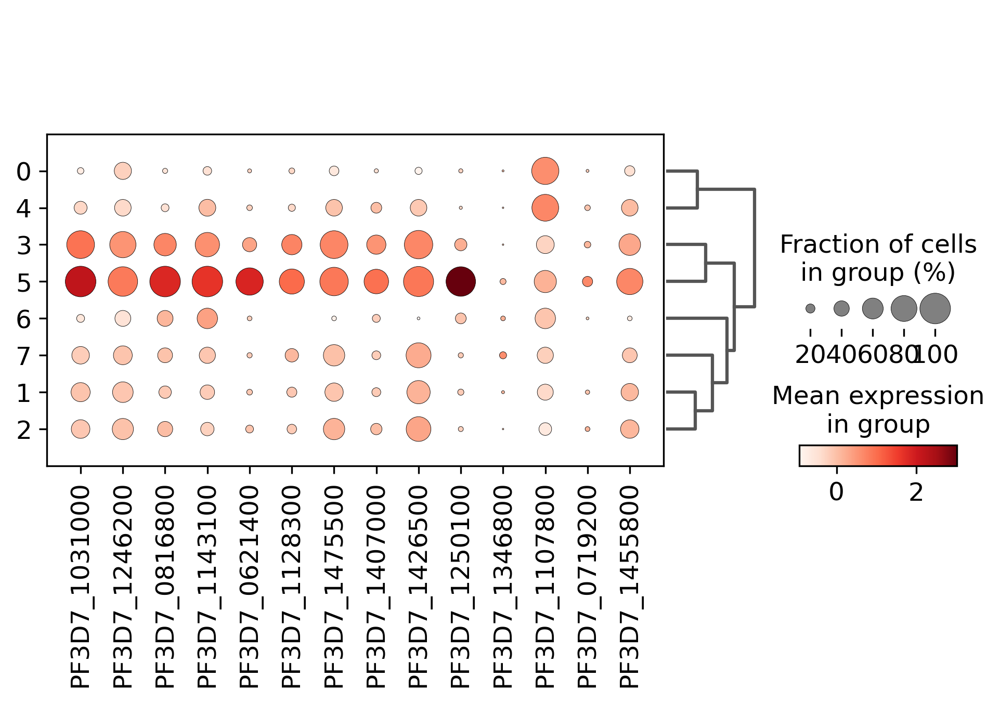

In [60]:
sc.pl.dotplot(adata, male_genes, groupby='clusters', dendrogram=True)#male markers
sc.pl.dotplot(adata, female_genes, groupby='clusters', dendrogram=True)#female markers

In [61]:
meta_data = adata.obs.copy()
meta_data.to_csv("../files/meta.data_SS2.csv", sep=";")

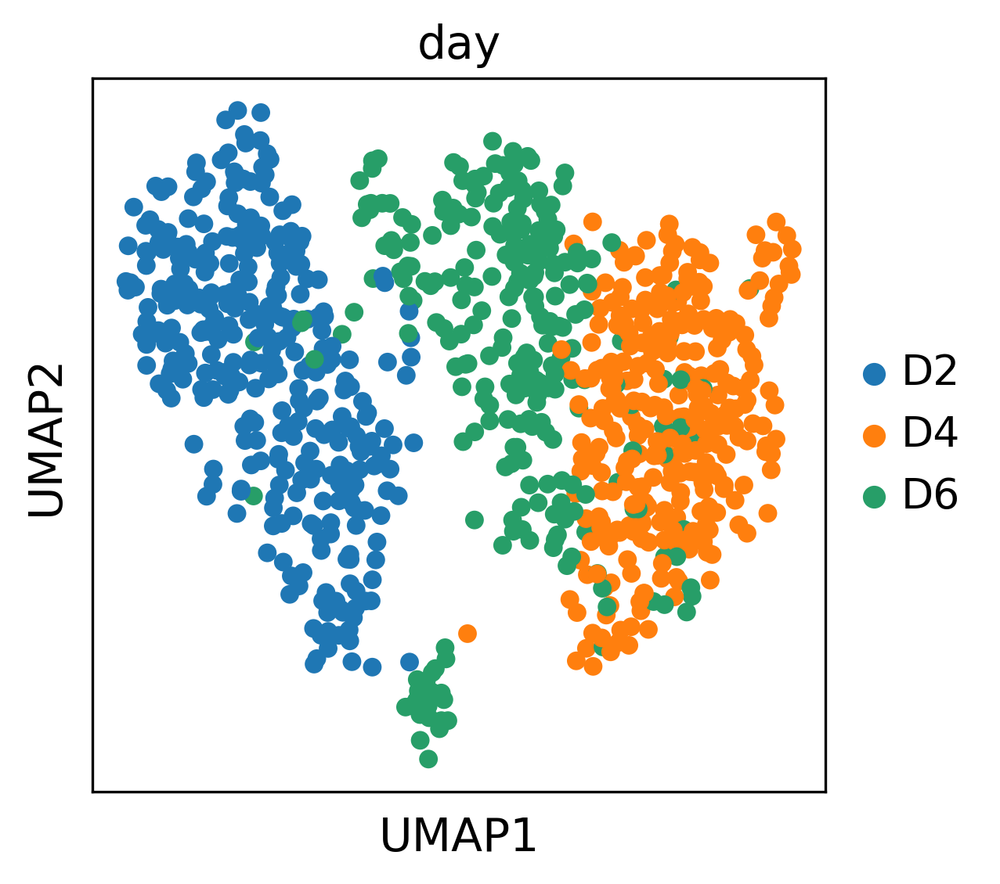

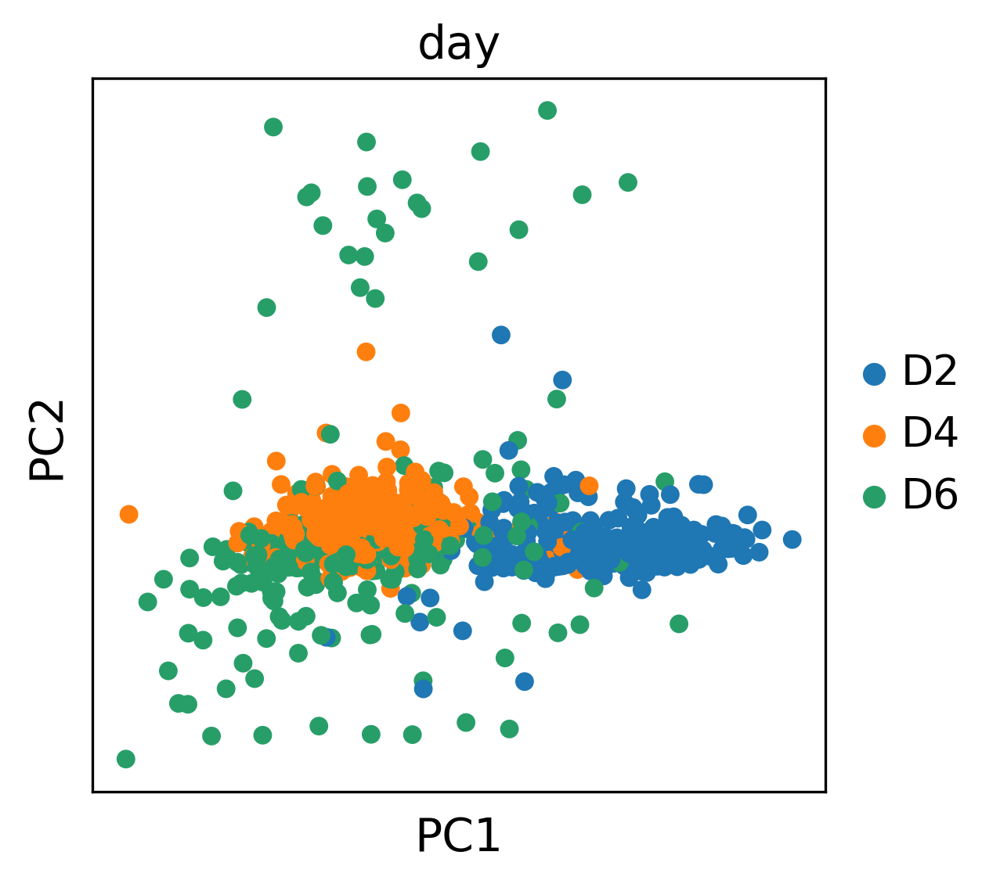

In [62]:
sc.pl.umap(adata, color='day')
sc.pl.pca(adata, color='day', edges=False)

In [63]:
adata

AnnData object with n_obs × n_vars = 916 × 5142
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'n_counts', 'louvain_0.4', 'leiden_0.4', 'louvain_0.6', 'leiden_0.6', 'louvain_0.8', 'leiden_0.8', 'louvain_0.9', 'leiden_0.9', 'louvain_1.0', 'leiden_1.0', 'louvain_1.1', 'leiden_1.1', 'louvain_1.2', 'leiden_1.2', 'louvain_1.4', 'leiden_1.4', 'louvain_1.6', 'leiden_1.6', 'clusters', 'day', 'S_score', 'G2M_score', 'phase'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'mal_rna', 'hb', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'louvain', 'leiden', 'louvain_0.4_colors', 'louvain_0.6_colors', 'louvain_0.8_colors', 'louvain_0.9_colors', 'louvain_1.0_colors', 'louvain_1.1_colors', 'louvain_1.2_colors', 'louvain_1.4_colors', 'louvain_1.6_colors', 'leiden_0.4_colors', 'leiden_0.6_colors', 'leiden_0.8_colors', 'leiden_0.9_colors', 'leiden_1.0_colors', 'leiden_1.1_colors', 'le

In [64]:
#adata.write_h5ad('./objects/SS2_gams_new.h5ad')

ranking genes
    finished: added to `.uns['wilcoxon']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


/home/mubasher/.conda/envs/spatial/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/mubasher/.conda/envs/spatial/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/mubasher/.conda/envs/spatial/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/mubasher/.conda/envs/spatial/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/mubasher/.conda/envs/spatial/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_

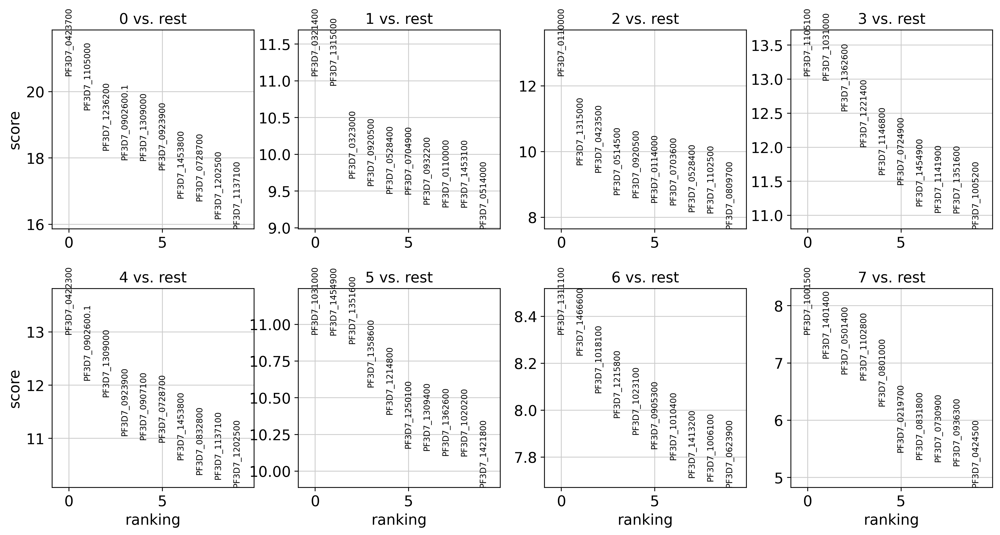

In [65]:
##DEG analysis
sc.tl.rank_genes_groups(adata, 'clusters', method='wilcoxon', key_added = "wilcoxon")
sc.pl.rank_genes_groups(adata, n_genes=10, sharey=False, key="wilcoxon")

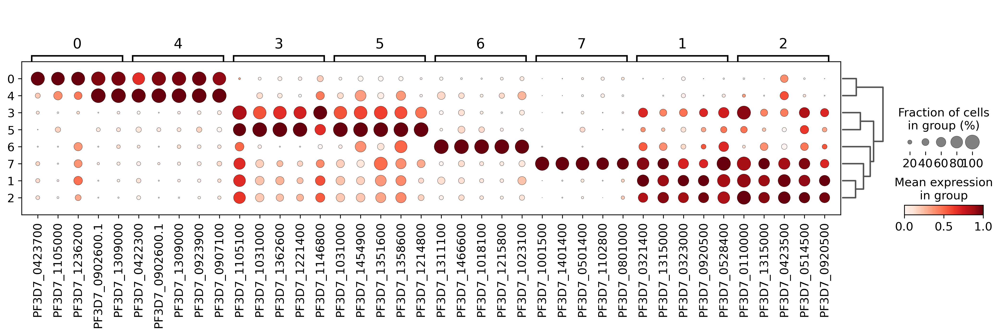

In [66]:
sc.settings.verbosity = 2
sc.pl.rank_genes_groups_dotplot(adata,n_genes=5, standard_scale='var', key="wilcoxon")

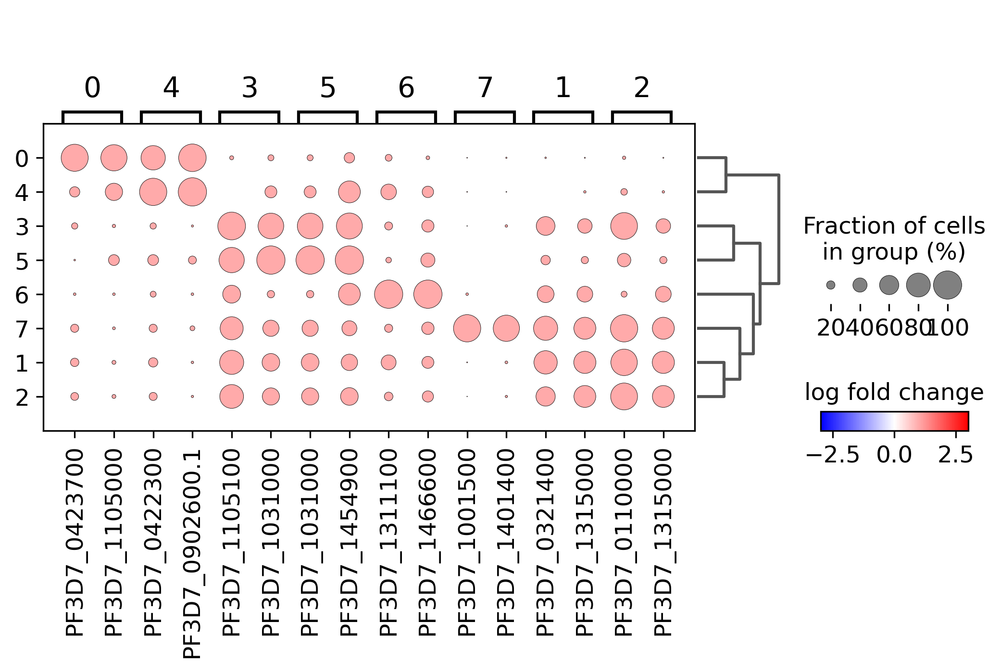

In [67]:
sc.pl.rank_genes_groups_dotplot(
    adata,
    n_genes=2,
    values_to_plot="logfoldchanges", cmap='bwr',
    vmin=-3,
    vmax=3,
    key="wilcoxon",
   
    colorbar_title='log fold change'
)

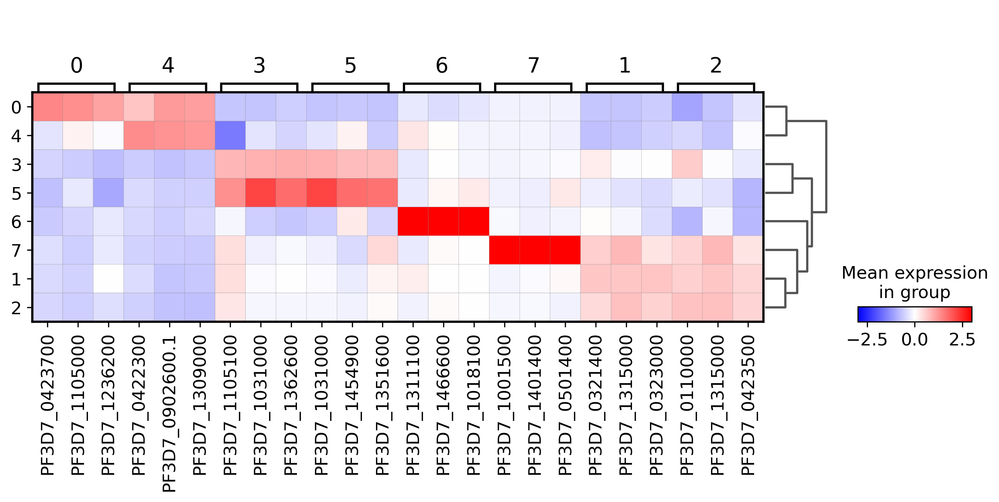

In [68]:
sc.pl.rank_genes_groups_matrixplot(adata, n_genes=3, key="wilcoxon", cmap='bwr', vmin=-3, vmax=3)

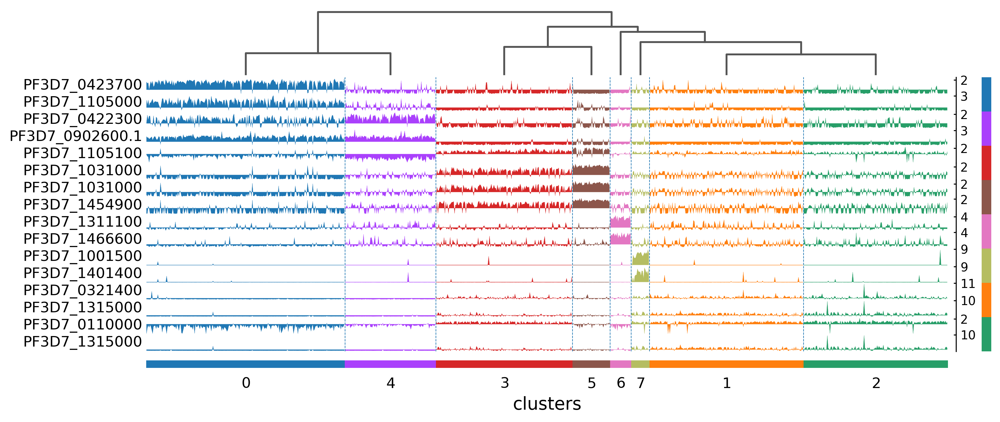

In [69]:
sc.pl.rank_genes_groups_tracksplot(adata, n_genes=2, key="wilcoxon")

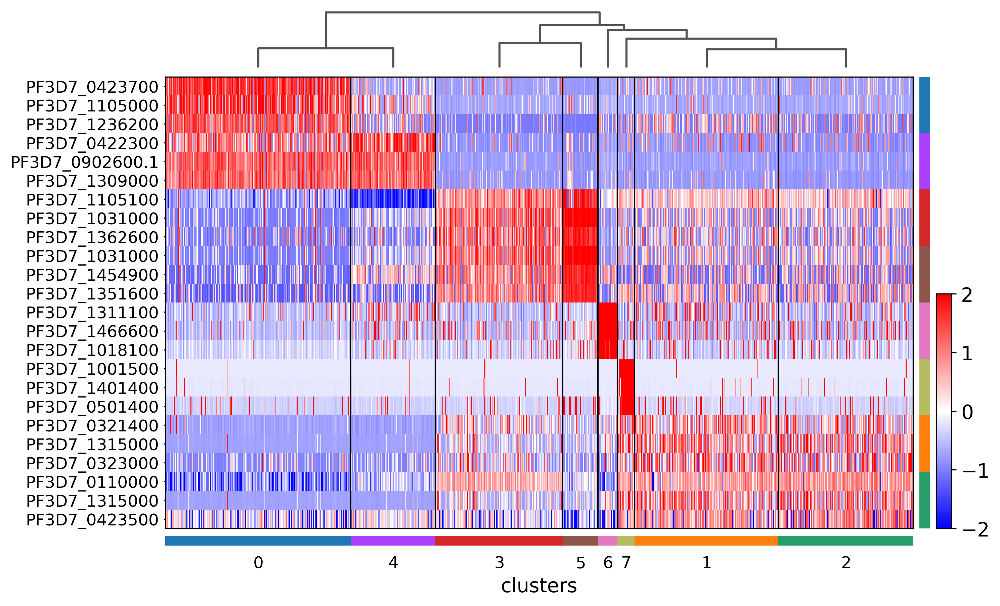

In [70]:
sc.pl.rank_genes_groups_heatmap(adata, n_genes=3, key="wilcoxon", cmap='bwr', swap_axes=True, vmin=-2, vmax=2, figsize=(10,7))

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_clusters']`


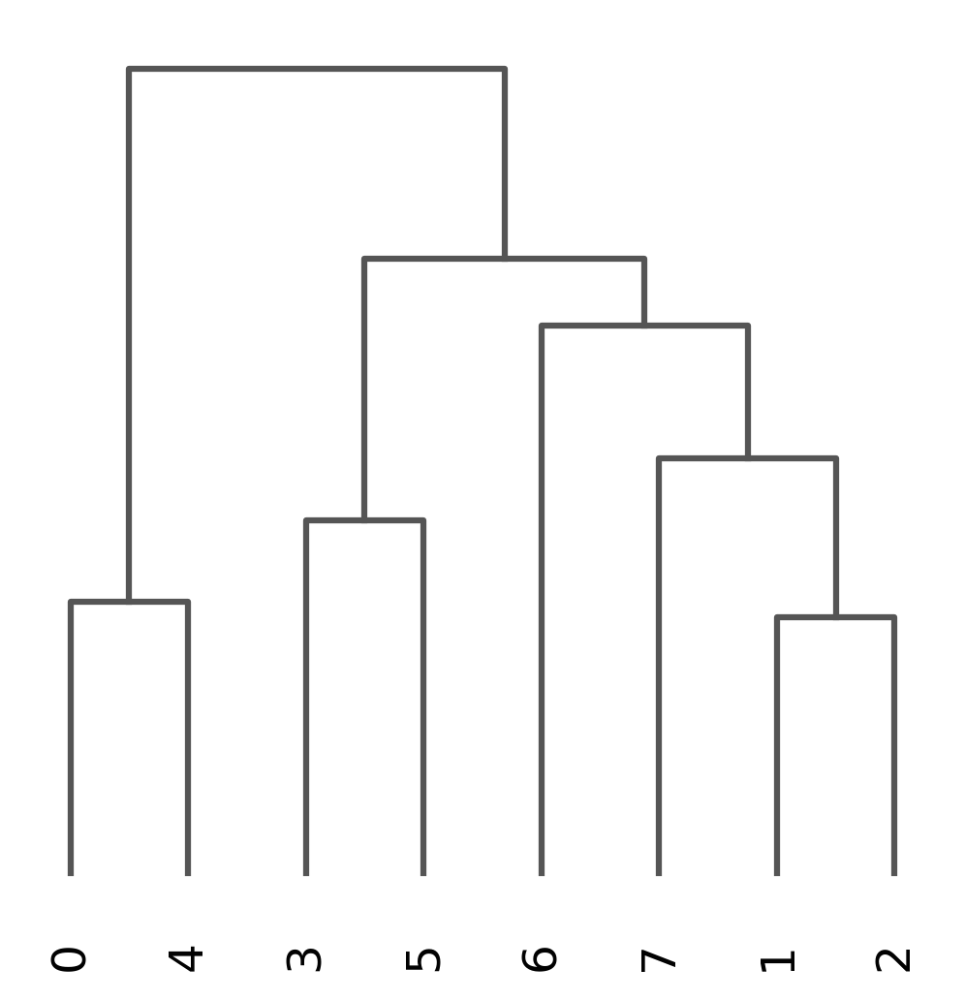

In [71]:
sc.tl.dendrogram(adata, 'clusters')
ax = sc.pl.dendrogram(adata, 'clusters')

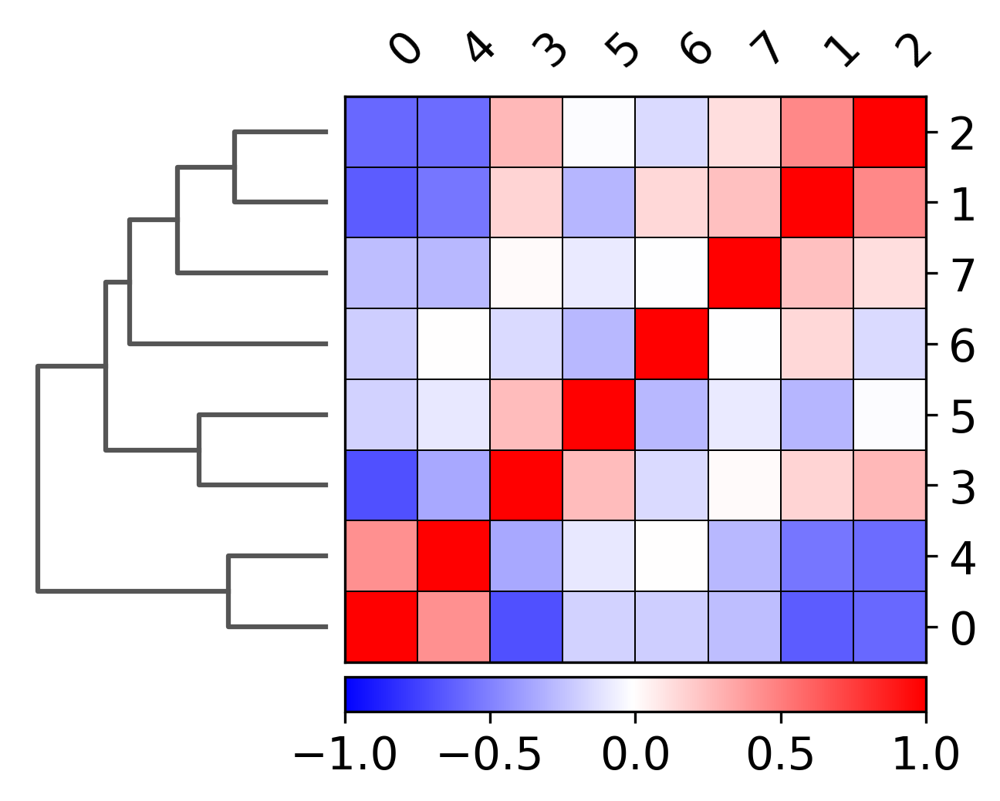

In [72]:
ax = sc.pl.correlation_matrix(adata, 'clusters', figsize=(5,3.5))

/home/mubasher/.conda/envs/spatial/lib/python3.9/site-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)


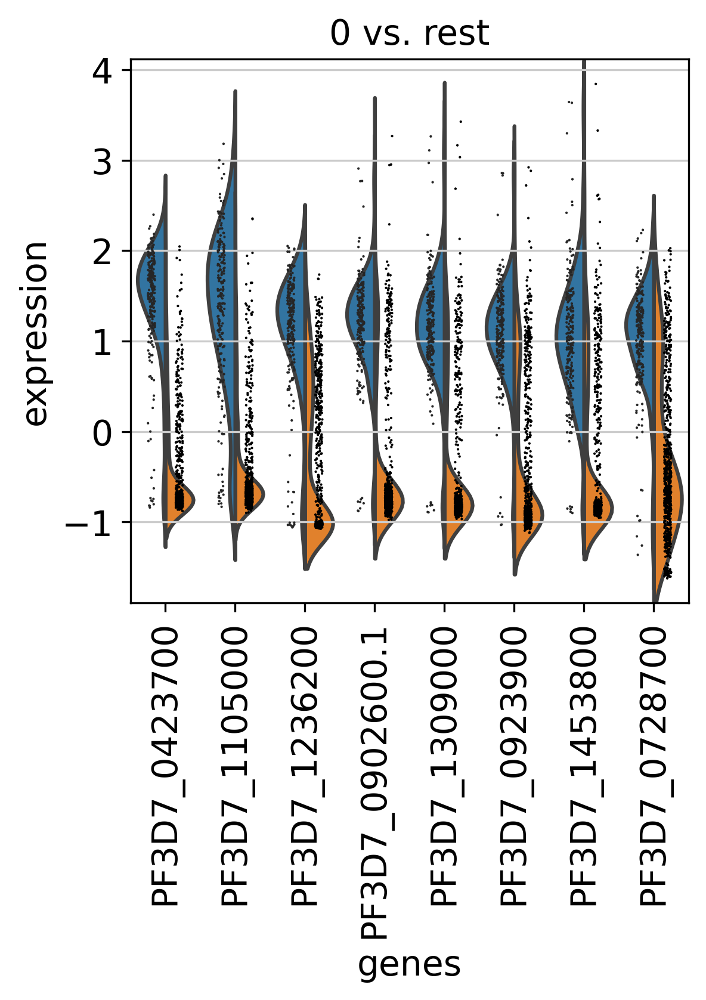

In [73]:
sc.pl.rank_genes_groups_violin(adata, groups='0', n_genes=8, key="wilcoxon")

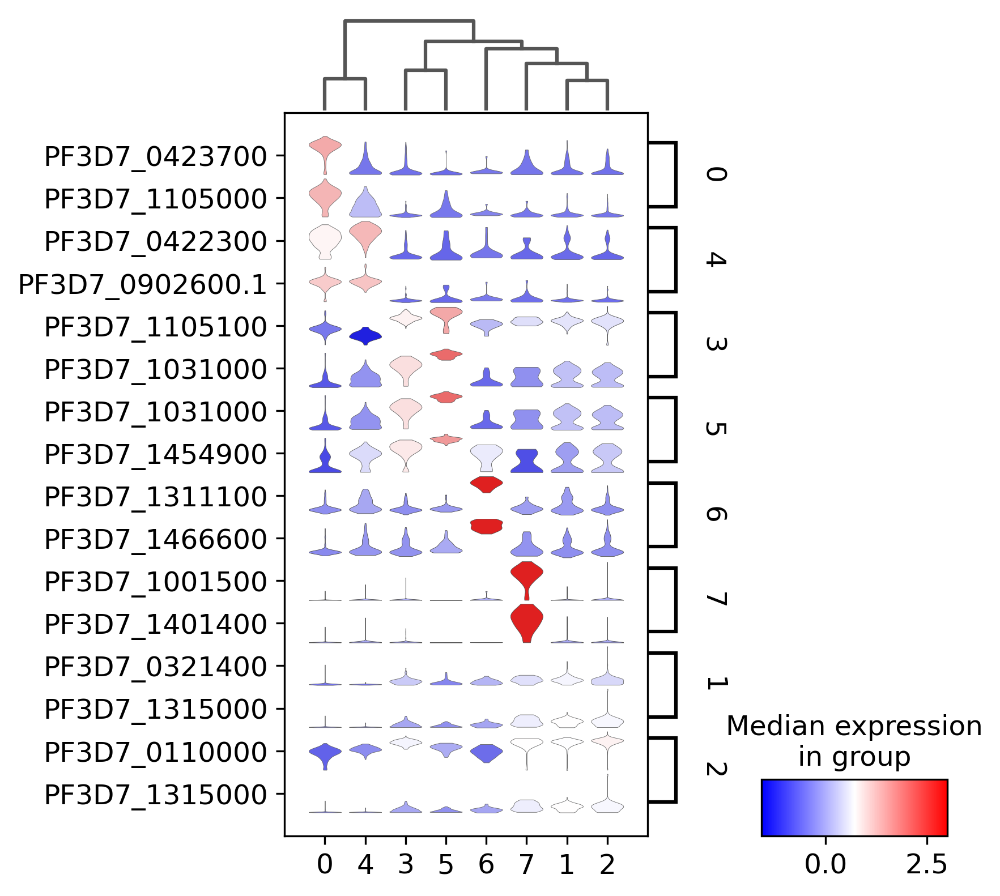

In [74]:
#sc.pl.stacked_violin(adata, genes, groupby='clusters', rotation=90)
sc.pl.rank_genes_groups_stacked_violin(adata, n_genes=2,swap_axes=True, vmax=3, key="wilcoxon", figsize=(5,6), cmap='bwr', dendrogram=True) # save="deg_top2_wlcoxn.png"

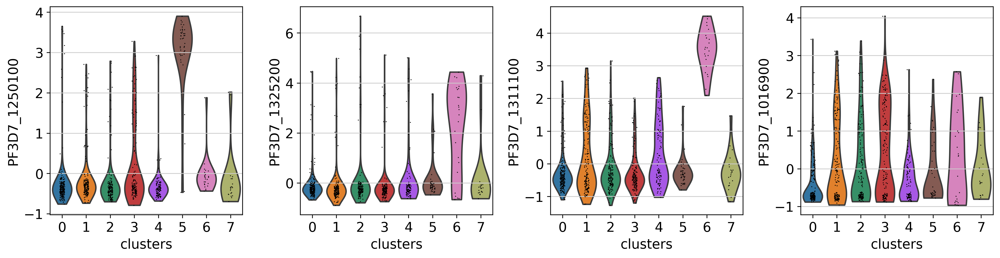

In [75]:
sc.pl.violin(adata, ["PF3D7_1250100", "PF3D7_1325200", "PF3D7_1311100", "PF3D7_1016900"], groupby='clusters')

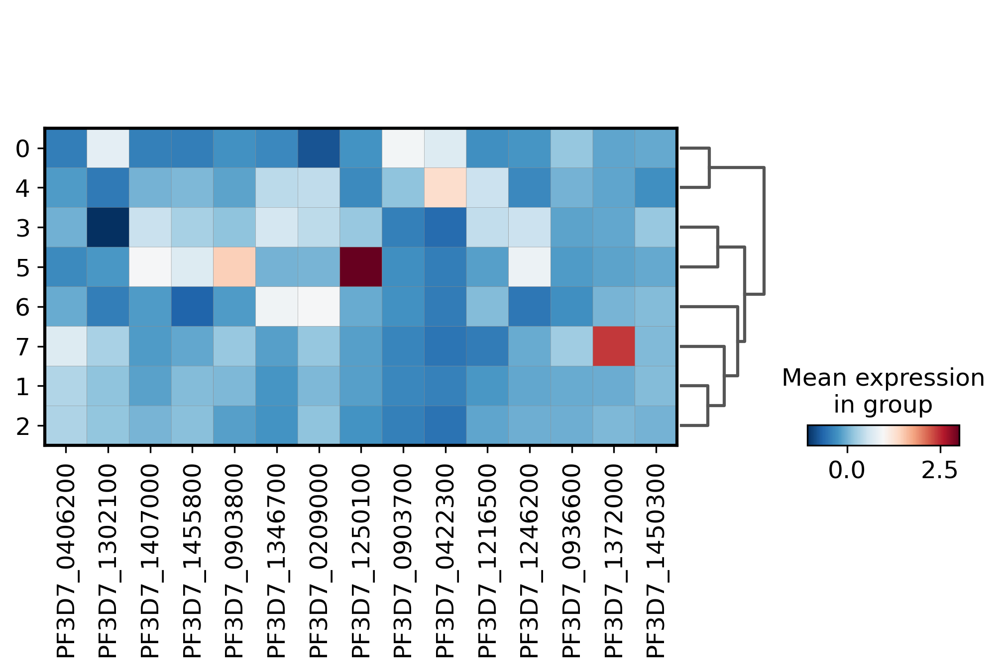

In [76]:
#gams stage markers 
stage_markers = [x.strip() for x in open('stage_markers.txt')]
sc.pl.matrixplot(adata, stage_markers, 'clusters', dendrogram=True, cmap='RdBu_r')

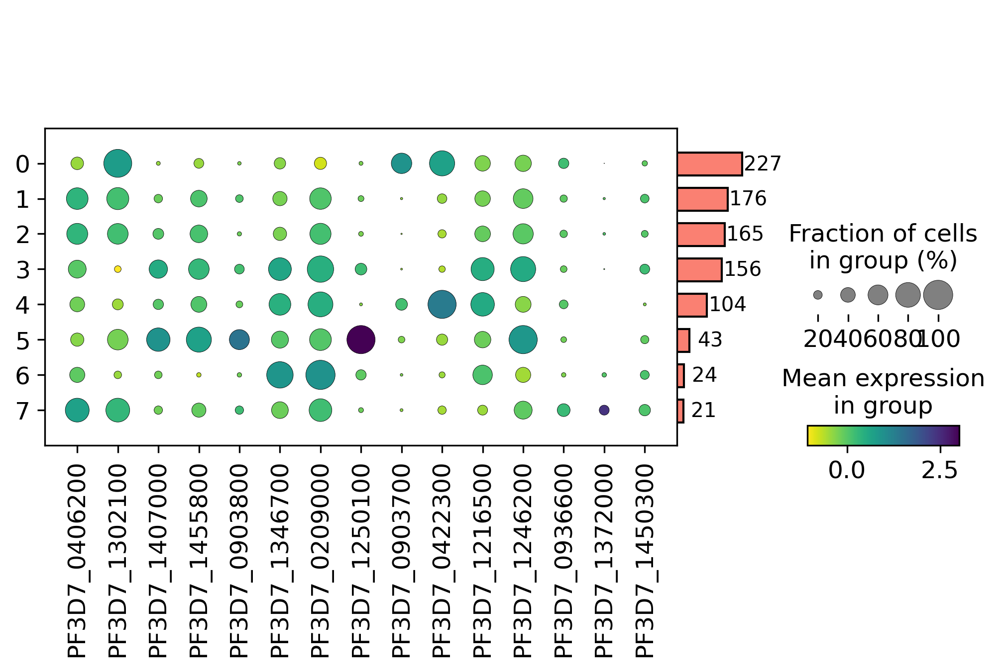

In [77]:
pd = sc.pl.dotplot(adata, stage_markers, return_fig=True, groupby='clusters', cmap='viridis_r').add_totals().show()

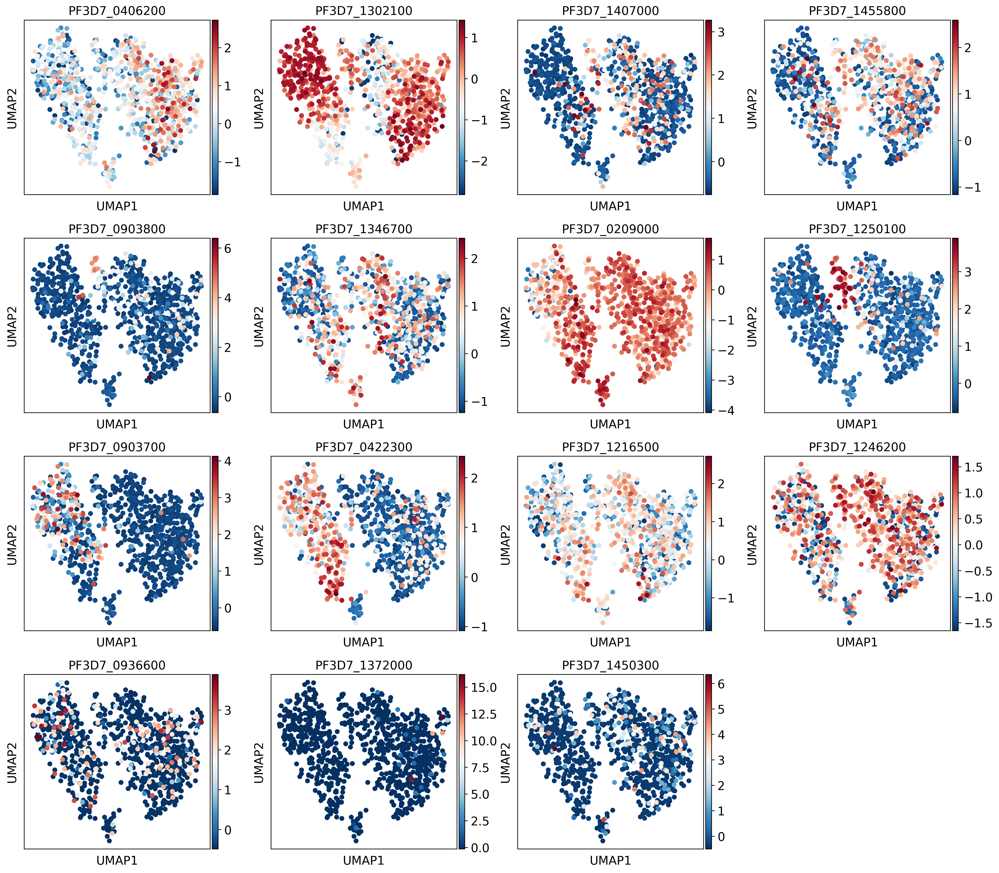

In [78]:
sc.pl.umap(adata, color = stage_markers, cmap='RdBu_r')

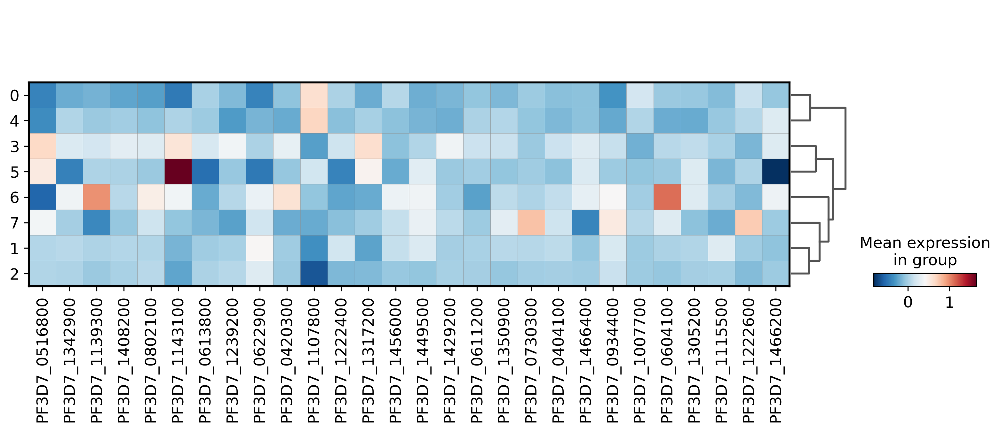

In [79]:
T_factors = [x.strip() for x in open('TF.txt')]
sc.pl.matrixplot(adata, T_factors, 'clusters', dendrogram=True, cmap='RdBu_r')

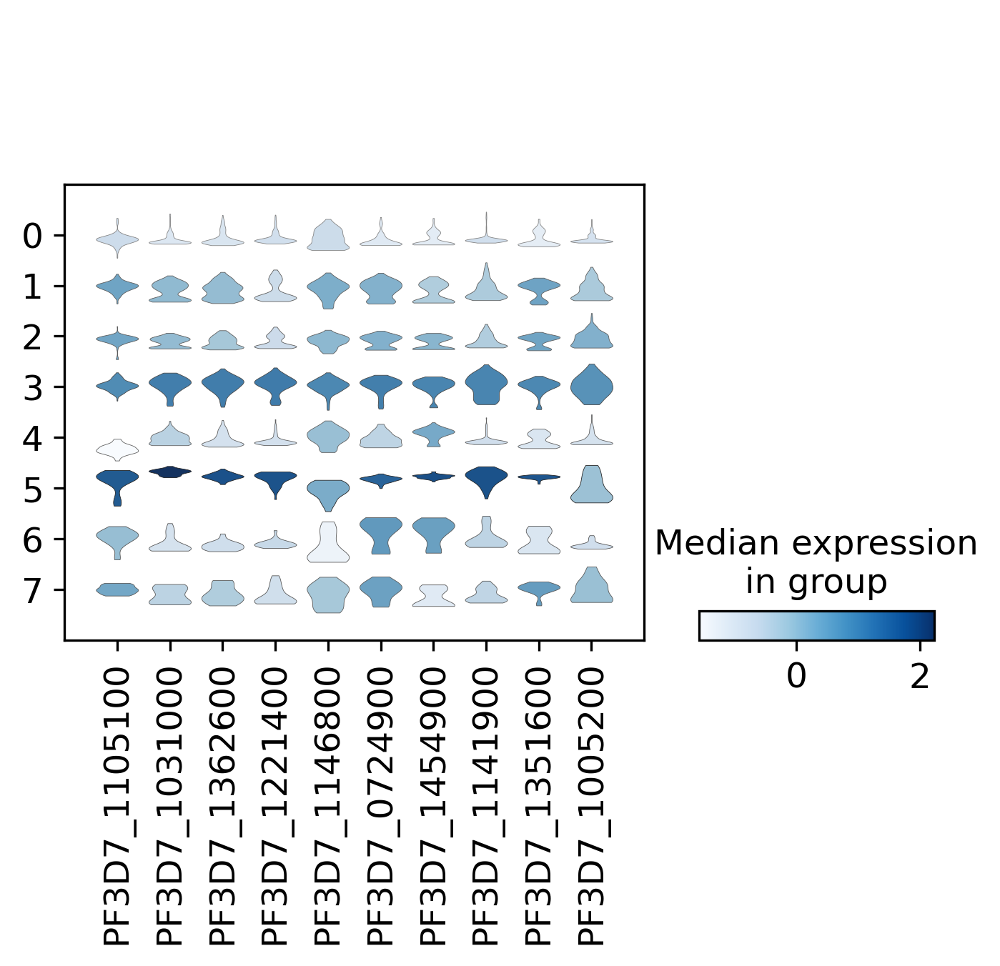

In [80]:
mynames = [x[3] for x in adata.uns['wilcoxon']['names'][:10]]
sc.pl.stacked_violin(adata, mynames, groupby = 'clusters')

In [81]:
sc.tl.score_genes(adata, T_factors, score_name='TF_score', use_raw=True)
pd = sc.pl.dotplot(adata, T_factors, return_fig=True, groupby='clusters', cmap='RdBu_r').add_totals().show()

computing score 'TF_score'


AttributeError: 'NoneType' object has no attribute 'var_names'

In [82]:
dp = sc.pl.dotplot(adata, ['TF_score'], return_fig=True, groupby='clusters', dendrogram=True).add_totals().show()

KeyError: "Could not find keys '['TF_score']' in columns of `adata.obs` or in adata.var_names."

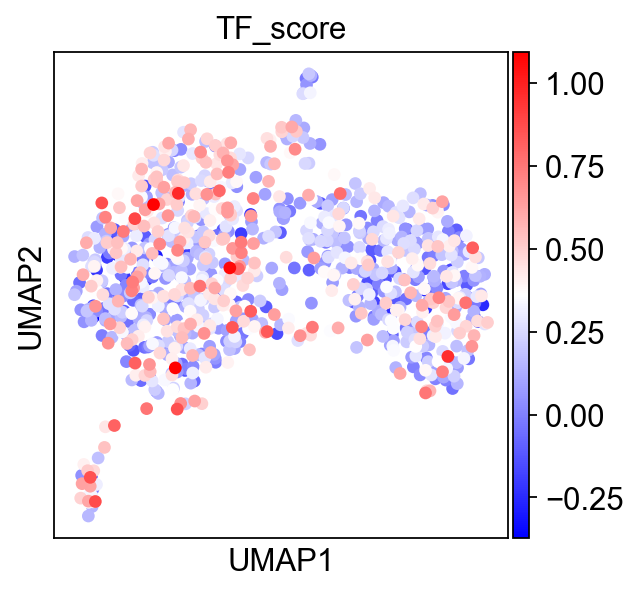

In [103]:
sc.pl.umap(adata, color= ['TF_score'], color_map='bwr', add_outline=False, legend_loc='on data',
               legend_fontsize=12, legend_fontoutline=2,frameon=True)

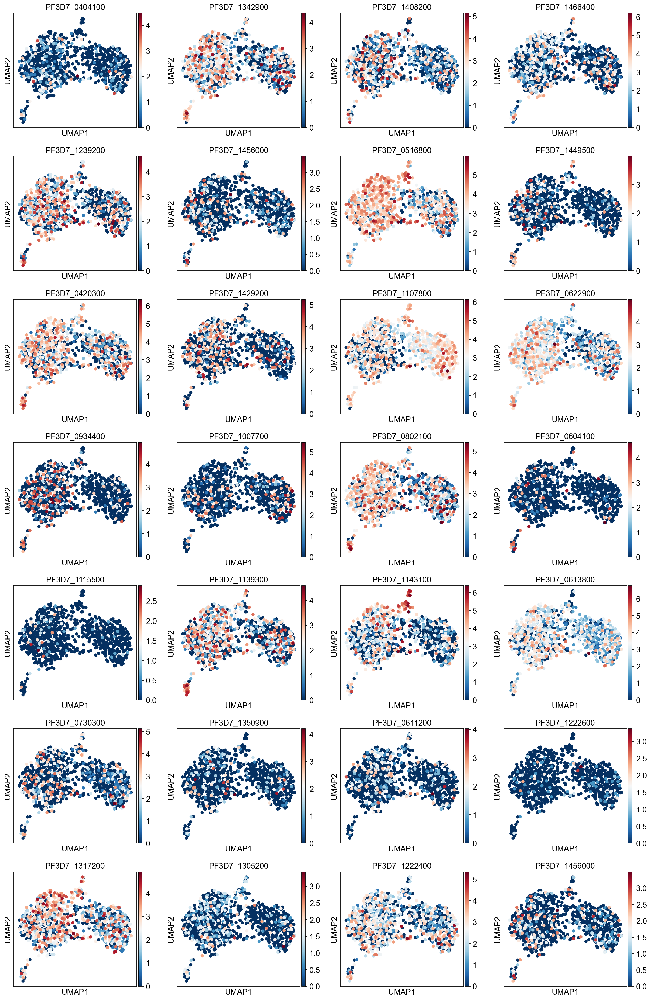

In [104]:
sc.pl.umap(adata, color = T_factors, cmap='RdBu_r')

In [3]:
adata.obs

,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,total_counts_ribo,pct_counts_ribo,total_counts_hb,pct_counts_hb,n_counts,...,leiden_1.0,louvain_1.1,leiden_1.1,louvain_1.2,leiden_1.2,louvain_1.4,leiden_1.4,louvain_1.6,leiden_1.6,day
A10_R1.17_532,851,851,15385.0,0.0,0.0,0.0,0.0,0.0,0.0,15385.0,...,0,0,0,5,4,4,5,4,1,D2
A10_R1.18_360,1283,1283,31910.0,0.0,0.0,0.0,0.0,0.0,0.0,31910.0,...,4,5,1,6,7,1,7,1,10,D4
A10_R1.18_361,1863,1863,56389.0,0.0,0.0,0.0,0.0,0.0,0.0,56389.0,...,2,1,5,0,6,2,6,7,5,D6
A11_R1.17_532,1047,1047,29169.0,0.0,0.0,0.0,0.0,0.0,0.0,29169.0,...,3,0,2,3,5,4,4,4,4,D2
A11_R1.18_360,1268,1268,23307.0,0.0,0.0,0.0,0.0,0.0,0.0,23307.0,...,1,3,3,1,3,1,0,1,0,D4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
N5_R1.17_532,1304,1304,44644.0,0.0,0.0,0.0,0.0,0.0,0.0,44644.0,...,3,4,2,4,8,5,8,5,7,D2
N5_R1.18_360,1109,1109,31858.0,0.0,0.0,0.0,0.0,0.0,0.0,31858.0,...,4,5,1,6,9,7,7,6,10,D4
N5_R1.18_361,1424,1424,46257.0,0.0,0.0,0.0,0.0,0.0,0.0,46257.0,...,5,6,6,7,10,6,9,8,8,D6
N6_R1.17_532,1321,1321,40676.0,0.0,0.0,0.0,0.0,0.0,0.0,40676.0,...,3,4,2,4,5,5,4,5,4,D2


In [33]:
df.to_csv('../files/SS2_metadata.csv')

In [27]:
df = adata.obs

In [28]:
df['cell_id'] = df.index

In [30]:
df.rename_axis('cell_id', inplace=True)

In [32]:
del df['cell_id']
df

,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,total_counts_ribo,pct_counts_ribo,total_counts_hb,pct_counts_hb,n_counts,...,leiden_1.0,louvain_1.1,leiden_1.1,louvain_1.2,leiden_1.2,louvain_1.4,leiden_1.4,louvain_1.6,leiden_1.6,day
cell_id,,,,,,,,,,,,,,,,,,,,,
A10_R1.17_532,851,851,15385.0,0.0,0.0,0.0,0.0,0.0,0.0,15385.0,...,0,0,0,5,4,4,5,4,1,D2
A10_R1.18_360,1283,1283,31910.0,0.0,0.0,0.0,0.0,0.0,0.0,31910.0,...,4,5,1,6,7,1,7,1,10,D4
A10_R1.18_361,1863,1863,56389.0,0.0,0.0,0.0,0.0,0.0,0.0,56389.0,...,2,1,5,0,6,2,6,7,5,D6
A11_R1.17_532,1047,1047,29169.0,0.0,0.0,0.0,0.0,0.0,0.0,29169.0,...,3,0,2,3,5,4,4,4,4,D2
A11_R1.18_360,1268,1268,23307.0,0.0,0.0,0.0,0.0,0.0,0.0,23307.0,...,1,3,3,1,3,1,0,1,0,D4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
N5_R1.17_532,1304,1304,44644.0,0.0,0.0,0.0,0.0,0.0,0.0,44644.0,...,3,4,2,4,8,5,8,5,7,D2
N5_R1.18_360,1109,1109,31858.0,0.0,0.0,0.0,0.0,0.0,0.0,31858.0,...,4,5,1,6,9,7,7,6,10,D4
N5_R1.18_361,1424,1424,46257.0,0.0,0.0,0.0,0.0,0.0,0.0,46257.0,...,5,6,6,7,10,6,9,8,8,D6
